# __MACAD GRAPH MACHINE LEARNING__
***
### James Foo and Andres Roncal

This notebook explore the relationship between property development and eviction rates in Manhattan, NY.

#### IMPORT DEPENDENCIES

In [1]:
import networkx as nx
import osmnx as ox
import geopandas as gpd
import pandas as pd
import momepy as mp
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.cm as cm
# import nx_altair as nxa
import shapely.geometry as geom
from itertools import islice
from collections import Counter
import sklearn as sk
from sklearn.cluster import KMeans
from tqdm import tqdm
import torch
import dgl
import matplotlib.patches as mpatches
import torch.nn as nn
import torch.nn.functional as F
from dgl.nn import SAGEConv
from shapely.geometry import Point, box

### 1. CREATE GRAPH OF MANHATTAN WITH OSMNX
***

In [2]:
place_name = "Manhattan Island, New York, United States"
G = ox.graph_from_place(place_name, network_type= 'walk', simplify = True)

In [3]:
area = ox.geocode_to_gdf(place_name)

### 2. ADD FEATURES TO GRAPH
***

#### FEATURE 1: EVICTIONS

This data set contains all recorded evictions from the year 2017 to May of 2024. 

In [4]:
#Load eviction data and filter data for Manhattan only
eviction_data = open("./Data/Evictions_20240516.csv")
eviction_df = pd.read_csv(eviction_data)
manhattan_evictions = eviction_df[eviction_df['BOROUGH'] == 'MANHATTAN']
clean_evictions = manhattan_evictions.dropna(subset = ['Latitude'])

In [5]:
geometry = gpd.points_from_xy(clean_evictions['Longitude'], clean_evictions['Latitude'])
manhattan_evictions_gdf = gpd.GeoDataFrame(clean_evictions, geometry= geometry)
manhattan_evictions_gdf.set_crs(epsg= 4326)

,Court Index Number,Docket Number,Eviction Address,Eviction Apartment Number,Executed Date,Marshal First Name,Marshal Last Name,Residential/Commercial,BOROUGH,Eviction Postcode,...,Eviction/Legal Possession,Latitude,Longitude,Community Board,Council District,Census Tract,BIN,BBL,NTA,geometry
3,74670/16,61667,535 WEST 110TH STREE T,3A,05/04/2017,Justin,Grossman,Residential,MANHATTAN,10025,...,Possession,40.803795,-73.965797,9.0,7.0,199.0,1056904.0,1.018820e+09,Morningside Heights,POINT (-73.96580 40.80380)
10,311118/22,6085,2915 FREDERICK DOUGLASS BLVD,4C,03/05/2024,David,Smith,Residential,MANHATTAN,10039,...,Possession,40.828736,-73.937611,10.0,9.0,23502.0,1060897.0,1.020470e+09,Central Harlem North-Polo Grounds,POINT (-73.93761 40.82874)
14,59878/19,18419,620 WEST 172ND STREE T,4A,08/13/2019,George,"Essock, Jr.",Residential,MANHATTAN,10032,...,Possession,40.844060,-73.939327,12.0,10.0,253.0,1063486.0,1.021420e+09,Washington Heights South,POINT (-73.93933 40.84406)
36,82266/16,9013,220 CABRINI BLVD,3D,01/30/2018,George,"Essock, Jr.",Residential,MANHATTAN,10033,...,Possession,40.854901,-73.938490,12.0,10.0,275.0,1064369.0,1.021790e+09,Washington Heights North,POINT (-73.93849 40.85490)
39,N60311/19,97948,267 WEST 146TH STREE T,16,10/03/2019,Ileana,Rivera,Residential,MANHATTAN,10039,...,Possession,40.823075,-73.940380,10.0,9.0,234.0,1060499.0,1.020320e+09,Central Harlem North-Polo Grounds,POINT (-73.94038 40.82308)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
91169,21087/18,34034,442 EAST 105TH ST,05B,05/07/2019,Bruce,Kemp,Residential,MANHATTAN,10029,...,Eviction,40.788265,-73.938952,11.0,8.0,162.0,1083950.0,1.016960e+09,East Harlem South,POINT (-73.93895 40.78827)
91195,080658/17,80051,106-108 WEST 109TH ST,3C,03/02/2018,Henry,Daley,Residential,MANHATTAN,10025,...,Possession,40.801398,-73.962010,7.0,7.0,193.0,1056007.0,1.018630e+09,Morningside Heights,POINT (-73.96201 40.80140)
91196,65769/19,357421,243 EAST 83RD STREET,5C,12/12/2019,Thomas,Bia,Residential,MANHATTAN,10028,...,Possession,40.776451,-73.954395,8.0,5.0,138.0,1048703.0,1.015290e+09,Yorkville,POINT (-73.95440 40.77645)
91197,65769/19,357421,243 EAST 83RD STREET,5C,12/12/2019,Thomas,Bia,Residential,MANHATTAN,10028,...,Possession,40.776451,-73.954395,8.0,5.0,138.0,1048703.0,1.015290e+09,Yorkville,POINT (-73.95440 40.77645)


In [6]:
eviction_gdf_points = manhattan_evictions_gdf[manhattan_evictions_gdf['geometry'].type == 'Point']
eviction_gdf_points.head()

,Court Index Number,Docket Number,Eviction Address,Eviction Apartment Number,Executed Date,Marshal First Name,Marshal Last Name,Residential/Commercial,BOROUGH,Eviction Postcode,...,Eviction/Legal Possession,Latitude,Longitude,Community Board,Council District,Census Tract,BIN,BBL,NTA,geometry
3,74670/16,61667,535 WEST 110TH STREE T,3A,05/04/2017,Justin,Grossman,Residential,MANHATTAN,10025,...,Possession,40.803795,-73.965797,9.0,7.0,199.0,1056904.0,1.018820e+09,Morningside Heights,POINT (-73.96580 40.80380)
10,311118/22,6085,2915 FREDERICK DOUGLASS BLVD,4C,03/05/2024,David,Smith,Residential,MANHATTAN,10039,...,Possession,40.828736,-73.937611,10.0,9.0,23502.0,1060897.0,1.020470e+09,Central Harlem North-Polo Grounds,POINT (-73.93761 40.82874)
14,59878/19,18419,620 WEST 172ND STREE T,4A,08/13/2019,George,"Essock, Jr.",Residential,MANHATTAN,10032,...,Possession,40.844060,-73.939327,12.0,10.0,253.0,1063486.0,1.021420e+09,Washington Heights South,POINT (-73.93933 40.84406)
36,82266/16,9013,220 CABRINI BLVD,3D,01/30/2018,George,"Essock, Jr.",Residential,MANHATTAN,10033,...,Possession,40.854901,-73.938490,12.0,10.0,275.0,1064369.0,1.021790e+09,Washington Heights North,POINT (-73.93849 40.85490)
39,N60311/19,97948,267 WEST 146TH STREE T,16,10/03/2019,Ileana,Rivera,Residential,MANHATTAN,10039,...,Possession,40.823075,-73.940380,10.0,9.0,234.0,1060499.0,1.020320e+09,Central Harlem North-Polo Grounds,POINT (-73.94038 40.82308)


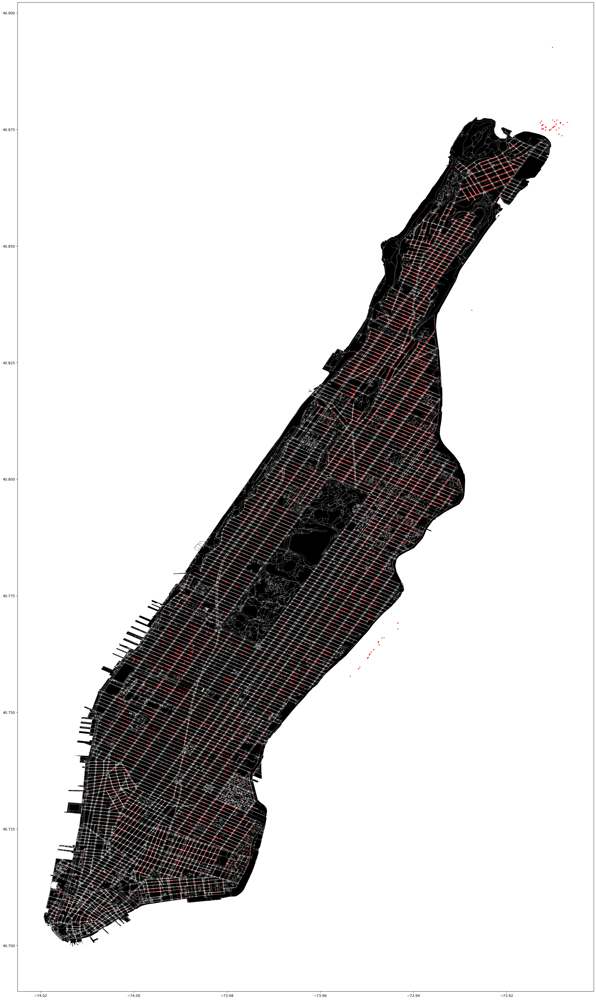

In [7]:
nodes, edges = ox.graph_to_gdfs(G)
fig, ax = plt.subplots(figsize=(30,50))
area.plot(ax = ax, facecolor = 'black')
edges.plot(ax = ax, linewidth = 0.2, edgecolor = 'white', facecolor = 'black')
nodes.plot(ax= ax, color = 'white', markersize = .1)
eviction_gdf_points.plot(ax= ax, markersize = 3, color = 'red')

plt.show()

##### Option A: Assign Edges
Assign values to their closest edge and assign the edge the total number of evictions associated with it.

In [8]:
#Count number of evicictions for each edge
close_edges = ox.distance.nearest_edges(G, eviction_gdf_points['geometry'].x, eviction_gdf_points['geometry'].y)
eviction_count = Counter(close_edges)
evictions = []

#Assign value to each edge
for i in edges.index:
    eviction = eviction_count[edges.loc[i].name]
    evictions.append(eviction)

max(evictions)
edges['evictions'] = evictions

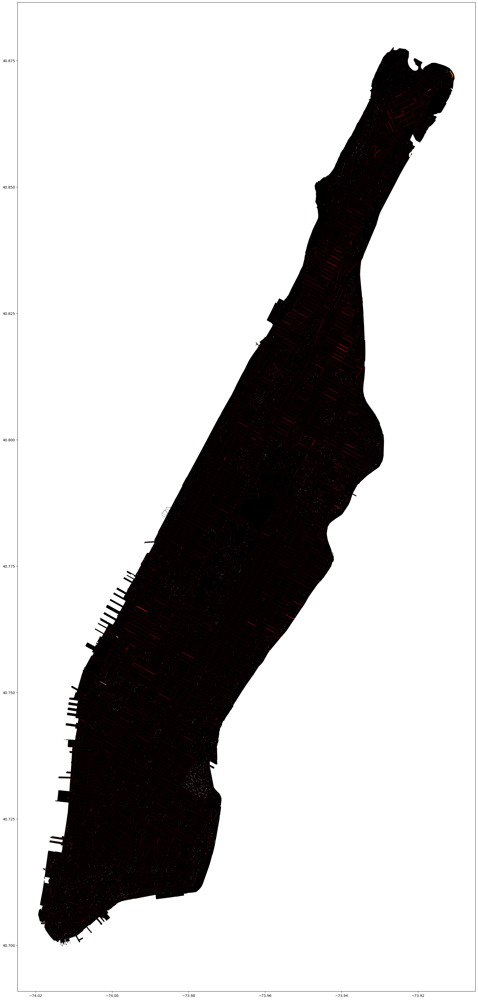

In [9]:
fig, ax = plt.subplots(figsize=(30,50))
area.plot(ax = ax, facecolor = 'black')
edges.plot(ax = ax, column = 'evictions', cmap = 'hot', linewidth = 1.5)
nodes.plot(ax= ax, color = 'white', markersize = .1)
# property_gdf.plot(ax= ax,  markersize = 0.5, color = 'blue')

plt.show()

##### Option B: Assign to Nodes

In [10]:
def place_boxes(points, width):
    return (gpd.GeoSeries([box(minx= p.x - width/2 , miny = p.y - width /2, maxx = p.x + width/2, maxy = p.y + width/2) for p in points]))

In [11]:
eviction_boxes = place_boxes(eviction_gdf_points['geometry'], .003)

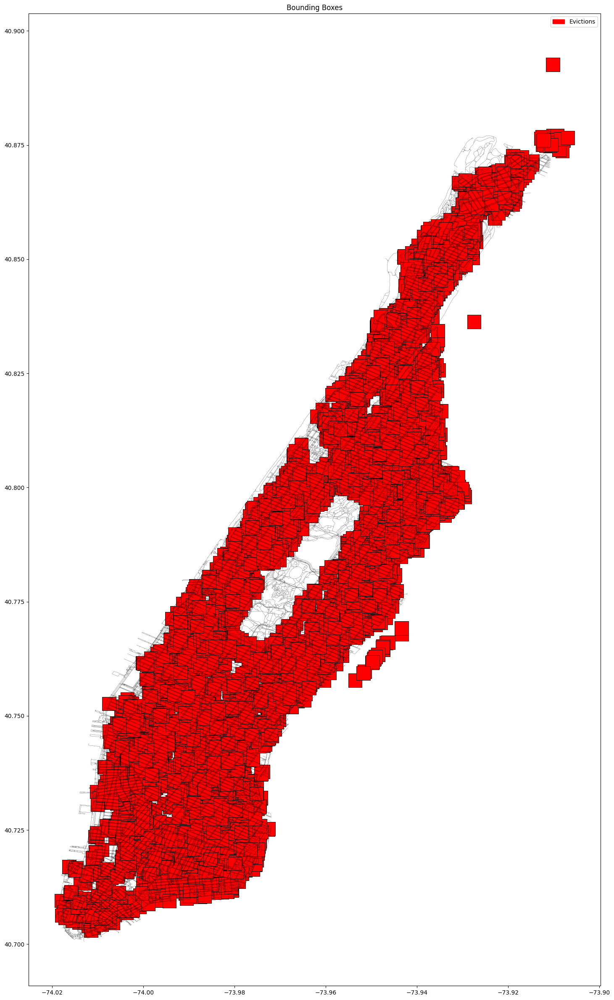

In [12]:
fig, ax = plt.subplots(figsize=(30,30))
#boundary.plot(ax=ax, facecolor='gray')
edges.plot(ax=ax, linewidth=0.1, edgecolor='black')
nodes.plot(ax=ax, color='black', markersize=0.0003)

eviction_boxes.plot(ax=ax,facecolor='red',color="red", markersize=5, edgecolor="black", linewidth=0.6)

#create a legend
eviction_patch = mpatches.Patch(color='red', label='Evictions')

plt.legend(handles=[eviction_patch] )
ax.set_title("Bounding Boxes")
plt.show()

In [13]:
node_points =  gpd.GeoSeries(gpd.points_from_xy(list(nodes['x']), list(nodes['y'])))
print(node_points)

0        POINT (-73.96358 40.79072)
1        POINT (-73.97438 40.77475)
2        POINT (-73.96004 40.79805)
3        POINT (-73.96147 40.79865)
4        POINT (-73.96287 40.79924)
                    ...            
46532    POINT (-74.00115 40.73385)
46533    POINT (-74.00126 40.73379)
46534    POINT (-73.92791 40.86620)
46535    POINT (-73.92804 40.86608)
46536    POINT (-73.92818 40.86617)
Length: 46537, dtype: geometry


In [14]:
nodes_osmid=list(nodes.index)
Points_spatialindex=list(node_points.index) 

osmId_spatialIndex = {}
[osmId_spatialIndex.update({i:j}) for i,j in zip(Points_spatialindex ,nodes_osmid)]
len(nodes_osmid)

46537

In [15]:
nearest_points_spatial_index_evictions =nodes.sindex.query(eviction_boxes)
print(f'centroids and graph nodes spatial index - Evicitons {nearest_points_spatial_index_evictions}')  #[0] first array is the indicies of each box and [1] the second array is the indicies of the included graph points
print(nearest_points_spatial_index_evictions.shape)

centroids and graph nodes spatial index - Evicitons [[    0     0     0 ... 13655 13655 13655]
 [38142 38286 38280 ... 45396 28709 28708]]
(2, 945395)


In [16]:
eviction_counter=Counter(nearest_points_spatial_index_evictions[1])

points_selections={}
for i in tqdm(node_points.index):
  points_selections[i]=[]
  points_selections[i].append(eviction_counter[i])

100%|██████████| 46537/46537 [00:00<00:00, 1569647.10it/s]


In [17]:
print(points_selections)

{0: [0], 1: [0], 2: [17], 3: [29], 4: [43], 5: [34], 6: [26], 7: [21], 8: [12], 9: [6], 10: [15], 11: [10], 12: [7], 13: [6], 14: [34], 15: [60], 16: [29], 17: [67], 18: [4], 19: [13], 20: [14], 21: [18], 22: [12], 23: [8], 24: [31], 25: [33], 26: [20], 27: [22], 28: [13], 29: [1], 30: [10], 31: [12], 32: [9], 33: [7], 34: [47], 35: [29], 36: [15], 37: [33], 38: [15], 39: [3], 40: [4], 41: [8], 42: [16], 43: [42], 44: [7], 45: [14], 46: [16], 47: [13], 48: [11], 49: [1], 50: [33], 51: [10], 52: [5], 53: [11], 54: [8], 55: [9], 56: [19], 57: [5], 58: [7], 59: [4], 60: [7], 61: [24], 62: [17], 63: [41], 64: [42], 65: [0], 66: [5], 67: [8], 68: [4], 69: [42], 70: [8], 71: [44], 72: [0], 73: [8], 74: [18], 75: [5], 76: [0], 77: [1], 78: [0], 79: [29], 80: [1], 81: [3], 82: [0], 83: [4], 84: [42], 85: [47], 86: [4], 87: [1], 88: [2], 89: [28], 90: [0], 91: [9], 92: [7], 93: [0], 94: [0], 95: [19], 96: [16], 97: [33], 98: [0], 99: [12], 100: [27], 101: [1], 102: [5], 103: [4], 104: [2], 105:

In [18]:
for i,j in zip(points_selections.keys(),points_selections.values()):
  if j[0]!=0:
    pass

In [19]:
nodes["evictions"]= [i[0] for i in points_selections.values()]
nodes

,y,x,street_count,highway,ref,geometry,evictions
osmid,,,,,,,
30807314,40.790720,-73.963576,4,NaN,NaN,POINT (-73.96358 40.79072),0
30978752,40.774754,-73.974383,4,NaN,NaN,POINT (-73.97438 40.77475),0
42421728,40.798048,-73.960044,3,traffic_signals,NaN,POINT (-73.96004 40.79805),17
42421731,40.798654,-73.961474,4,traffic_signals,NaN,POINT (-73.96147 40.79865),29
42421737,40.799244,-73.962873,4,traffic_signals,NaN,POINT (-73.96287 40.79924),43
...,...,...,...,...,...,...,...
11987722733,40.733852,-74.001146,4,crossing,NaN,POINT (-74.00115 40.73385),10
11987722734,40.733791,-74.001256,4,NaN,NaN,POINT (-74.00126 40.73379),10
11987755568,40.866205,-73.927915,4,NaN,NaN,POINT (-73.92791 40.86620),40


#### FEATURE 2: PROPERTY VALUE

In [20]:
property_df = pd.read_csv('./Data/cleaned_property_data.zip')


c:\Users\jfoo\AppData\Local\miniconda3\envs\graphml\lib\site-packages\IPython\core\interactiveshell.py:3508: DtypeWarning: Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [21]:
geometry = gpd.points_from_xy(property_df['Longitude'], property_df['Latitude'])
property_gdf = gpd.GeoDataFrame(property_df, geometry= geometry)
property_gdf.set_crs(epsg= 4326)

,Unnamed: 0,Unnamed: 0.1,BBLE,BORO,BLOCK,LOT,BLDGCL,TAXCLASS,LTFRONT,LTDEPTH,...,Borough,Latitude,Longitude,Community Board,Council District,Census Tract,BIN,NTA,New Georeferenced Column,geometry
0,0,3514,1009281654,1,928,1654,R4,2,0,0,...,MANHATTAN,40.736451,-73.978732,106.0,2.0,64.0,1086124.0,Gramercy,POINT (-73.978732 40.736451),POINT (-73.97873 40.73645)
1,1,3519,1009281661,1,928,1661,R4,2,0,0,...,MANHATTAN,40.736451,-73.978732,106.0,2.0,64.0,1086124.0,Gramercy,POINT (-73.978732 40.736451),POINT (-73.97873 40.73645)
2,2,3544,1010511417,1,1051,1417,R4,2,0,0,...,MANHATTAN,40.759212,-73.994510,104.0,3.0,115.0,1088437.0,Clinton,POINT (-73.99451 40.759212),POINT (-73.99451 40.75921)
3,3,7066,1006371201,1,637,1201,R8,2C,0,0,...,MANHATTAN,40.735330,-74.009670,102.0,3.0,75.0,1012003.0,West Village,POINT (-74.00967 40.73533),POINT (-74.00967 40.73533)
4,4,10598,1002791006,1,279,1006,R1,2C,0,0,...,MANHATTAN,40.712189,-73.997843,103.0,1.0,27.0,1003389.0,Chinatown,POINT (-73.997843 40.712189),POINT (-73.99784 40.71219)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1341054,1341054,8925107,1019480024,1,1948,24,G7,4,25,100,...,MANHATTAN,40.807889,-73.953676,110.0,9.0,257.0,1000000.0,Central Harlem South,POINT (-73.953676 40.807889),POINT (-73.95368 40.80789)
1341055,1341055,8925108,1021440003,1,2144,3,I9,4,50,100,...,MANHATTAN,40.846186,-73.937623,112.0,10.0,263.0,1089928.0,Washington Heights South,POINT (-73.937623 40.846186),POINT (-73.93762 40.84619)
1341056,1341056,8925110,1021410029,1,2141,29,D7,2,139,95,...,MANHATTAN,40.843846,-73.938775,112.0,10.0,253.0,1063463.0,Washington Heights South,POINT (-73.938775 40.843846),POINT (-73.93878 40.84385)
1341057,1341057,8925111,1020251006,1,2025,1006,R2,2,72,100,...,MANHATTAN,40.818687,-73.941926,110.0,9.0,230.0,1060373.0,Central Harlem North-Polo Grounds,POINT (-73.941926 40.818687),POINT (-73.94193 40.81869)


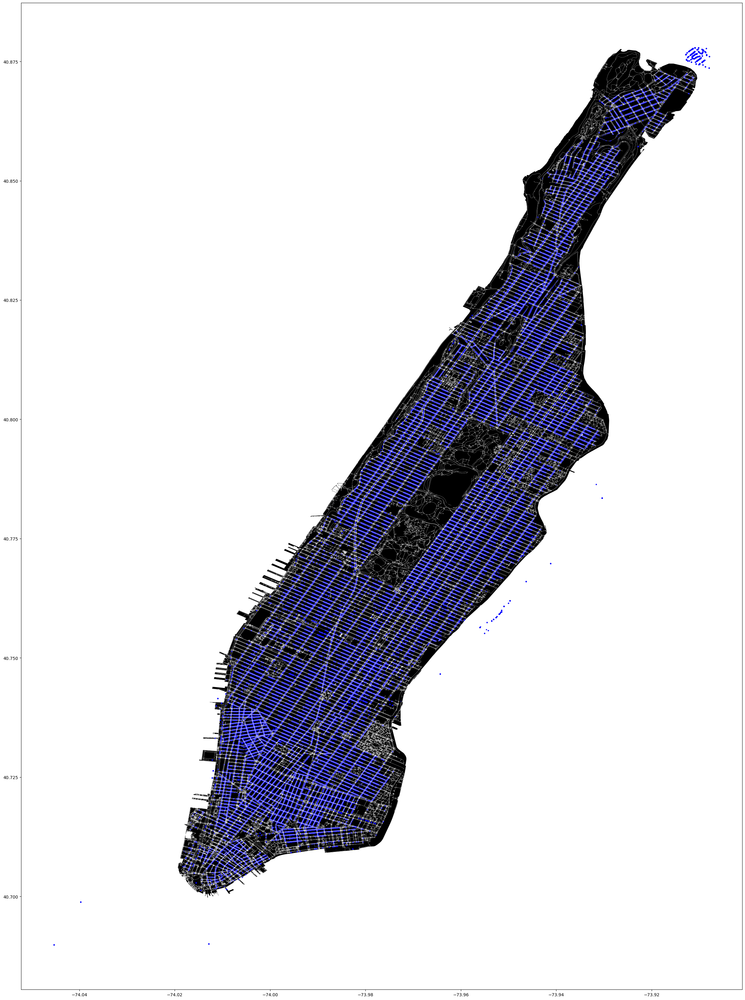

In [22]:
property_gdf_points = property_gdf[property_gdf['geometry'].type == 'Point']

fig, ax = plt.subplots(figsize=(30,50))
area.plot(ax = ax, facecolor = 'black')
edges.plot(ax = ax, linewidth = 0.2, edgecolor = 'white', facecolor = 'black')
nodes.plot(ax= ax, color = 'white', markersize = .1)
property_gdf_points.plot(ax= ax, markersize = 3, color = 'blue')

plt.show()

In [23]:
nearest_edges = ox.distance.nearest_edges(G, property_gdf['geometry'].x, property_gdf['geometry'].y)
edge_values = {edge: [] for edge in nearest_edges}

In [24]:
for i, edge in enumerate(nearest_edges):
    edge_values[edge].append(property_gdf.iloc[i]['AVTOT'])

In [25]:
# print(list(islice(edge_values.items(), 1)))

In [26]:
for edge, values in edge_values.items():
    avg_value = np.mean(values)
    print(avg_value)
    u, v, key = edge
    edges.loc[(u,v,key), 'Average Value'] = avg_value

edges = edges.fillna(0)

548511.1117647059
834887.9142857143
236484.12260536398
188864.37037037036
643047.25
173439.88571428572
89438.91735084838
429530.4888888889
113799.35900852879
152498.16645807258
104185.17789131445
235895.20512820513
618225.2037037037
202416.28265107214
24901257.583333332
174955.91228070174
1080696.292929293
124806.88696210661
174191.02035886818
390502.9292035398
160437.0318230852
223284.76388888888
488908.7239583333
147525.67336860672
171775.0
139462.3525449102
112191.39772496445
174494.83092783505
117517.71028806585
147380.05364511692
34565.71206690562
282991.44444444444
257078.32569360675
124199.94962686567
245823.87671232875
249204.59081836327
844146.6031746032
131325.01880341882
123660.1283917935
119668.31573157315
325698.3241758242
48420870.85714286
197345.27694859038
98132.30202020203
363089.5659287777
664513.9895522388
743290.784
2657400.0
174234.10014947684
1020847.5
101958.4735432016
164055.97844311377
92583.34197651663
229644.43901035673
331810.29440389294
442216.5664451827
32

In [27]:
from sklearn.preprocessing import StandardScaler
value_scaler = StandardScaler()

edges['Scaled Value'] = value_scaler.fit_transform(np.array(edges['Average Value']).reshape(-1,1))

(array([1.59143e+05, 4.95000e+02, 2.17000e+02, 1.03000e+02, 6.20000e+01,
        4.80000e+01, 2.80000e+01, 2.10000e+01, 2.30000e+01, 1.70000e+01,
        8.00000e+00, 5.00000e+00, 8.00000e+00, 7.00000e+00, 6.00000e+00,
        3.00000e+00, 1.00000e+00, 4.00000e+00, 2.00000e+00, 5.00000e+00,
        2.00000e+00, 4.00000e+00, 1.00000e+00, 0.00000e+00, 0.00000e+00,
        2.00000e+00, 0.00000e+00, 1.00000e+00, 1.00000e+00, 2.00000e+00,
        0.00000e+00, 0.00000e+00, 1.00000e+00, 0.00000e+00, 0.00000e+00,
        0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00,
        0.00000e+00, 1.00000e+00, 1.00000e+00, 0.00000e+00, 0.00000e+00,
        0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00,
        0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00,
        0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00,
        0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00,
        0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00

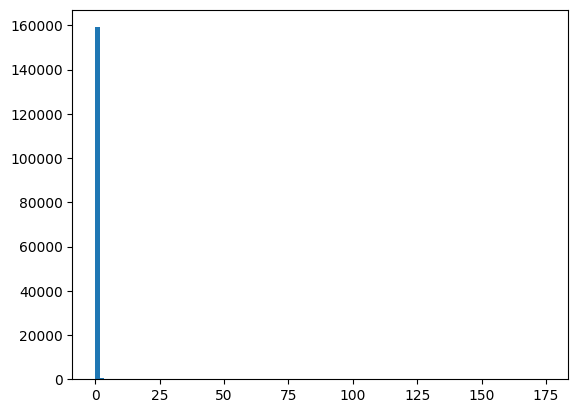

In [28]:
plt.hist(edges['Scaled Value'], bins=100)

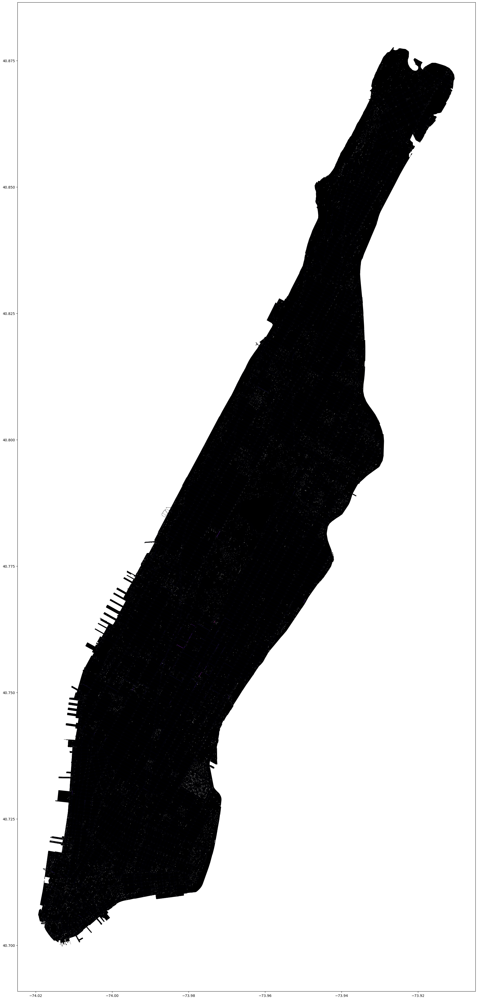

In [29]:
fig, ax = plt.subplots(figsize=(30,50))
area.plot(ax = ax, facecolor = 'black')
edges.plot(ax = ax, column = 'Scaled Value', cmap = 'magma', linewidth = 1)
nodes.plot(ax= ax, color = 'white', markersize = .1)
# property_gdf.plot(ax= ax,  markersize = 0.5, color = 'blue')

plt.show()

#### FEATURE 3: HOUSING PROJECTS SINCE 2010

In [30]:
construction_data = open('./Data/HousingDB_post2010.csv')
construction_df = pd.read_csv(construction_data)
manhattan_construction = construction_df[construction_df['Boro']==1]
clean_construction = manhattan_construction.dropna(subset = ['Latitude'])
clean_construction.head()

c:\Users\jfoo\AppData\Local\miniconda3\envs\graphml\lib\site-packages\IPython\core\interactiveshell.py:3508: DtypeWarning: Columns (0,21,28,29,30,36) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


,Job_Number,Job_Type,ResidFlag,NonresFlag,Job_Status,CompltYear,PermitYear,ClassAInit,ClassAProp,ClassANet,...,FireBattln,FireDivsn,PolicePcnt,PL_FIRM07,PL_PFIRM15,Latitude,Longitude,GeomSource,DCPEdited,Version
0,102133451,Alteration,Residential,NaN,3. Permitted for Construction,NaN,2003.0,8,8,0,...,1.0,1.0,1.0,NaN,NaN,40.719845,-74.009588,BIN DOB buildingfootprints,otherb_init/hotel_init/hotel_prop/otherb_prop/...,23Q4
1,102138820,Alteration,Residential,NaN,5. Completed Construction,2012.0,2008.0,6,19,13,...,11.0,3.0,24.0,NaN,NaN,40.796741,-73.962554,BIN DOB buildingfootprints,otherb_init/hotel_prop/otherb_prop/hotel_init/...,23Q4
2,102151083,Alteration,Residential,NaN,5. Completed Construction,2011.0,2002.0,7,9,2,...,4.0,1.0,9.0,NaN,NaN,40.722545,-73.982291,BIN DOB buildingfootprints,NaN,23Q4
3,102284172,Alteration,Residential,Non-Residential,5. Completed Construction,2016.0,2001.0,1,1,0,...,6.0,1.0,9.0,NaN,NaN,40.726385,-73.992369,BIN DOB buildingfootprints,classa_init,23Q4
4,102284804,Alteration,Residential,NaN,5. Completed Construction,2022.0,2001.0,4,4,0,...,6.0,1.0,6.0,NaN,NaN,40.728763,-74.000817,BIN DOB buildingfootprints,hotel_prop/hotel_init/classa_init/otherb_init/...,23Q4


In [31]:
construction_geometry = gpd.points_from_xy(clean_construction['Longitude'], clean_construction['Latitude'])
construction_gdf = gpd.GeoDataFrame(clean_construction, geometry = construction_geometry)
construction_gdf.set_crs(epsg = 4326)
# new_construction = construction_gdf[construction_gdf['Job_Type'] == 'New Building']

,Job_Number,Job_Type,ResidFlag,NonresFlag,Job_Status,CompltYear,PermitYear,ClassAInit,ClassAProp,ClassANet,...,FireDivsn,PolicePcnt,PL_FIRM07,PL_PFIRM15,Latitude,Longitude,GeomSource,DCPEdited,Version,geometry
0,102133451,Alteration,Residential,NaN,3. Permitted for Construction,NaN,2003.0,8,8,0,...,1.0,1.0,NaN,NaN,40.719845,-74.009588,BIN DOB buildingfootprints,otherb_init/hotel_init/hotel_prop/otherb_prop/...,23Q4,POINT (-74.00959 40.71984)
1,102138820,Alteration,Residential,NaN,5. Completed Construction,2012.0,2008.0,6,19,13,...,3.0,24.0,NaN,NaN,40.796741,-73.962554,BIN DOB buildingfootprints,otherb_init/hotel_prop/otherb_prop/hotel_init/...,23Q4,POINT (-73.96255 40.79674)
2,102151083,Alteration,Residential,NaN,5. Completed Construction,2011.0,2002.0,7,9,2,...,1.0,9.0,NaN,NaN,40.722545,-73.982291,BIN DOB buildingfootprints,NaN,23Q4,POINT (-73.98229 40.72254)
3,102284172,Alteration,Residential,Non-Residential,5. Completed Construction,2016.0,2001.0,1,1,0,...,1.0,9.0,NaN,NaN,40.726385,-73.992369,BIN DOB buildingfootprints,classa_init,23Q4,POINT (-73.99237 40.72639)
4,102284804,Alteration,Residential,NaN,5. Completed Construction,2022.0,2001.0,4,4,0,...,1.0,6.0,NaN,NaN,40.728763,-74.000817,BIN DOB buildingfootprints,hotel_prop/hotel_init/classa_init/otherb_init/...,23Q4,POINT (-74.00082 40.72876)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
69351,M08055337,Alteration,Residential,Non-Residential,2. Approved Application,NaN,NaN,2,2,0,...,1.0,9.0,NaN,NaN,40.727461,-73.990142,BIN DOB buildingfootprints,NaN,23Q4,POINT (-73.99014 40.72746)
69352,M08055390,Alteration,Residential,NaN,1. Filed Application,NaN,NaN,6,6,0,...,3.0,28.0,NaN,NaN,40.804428,-73.948899,BIN DOB buildingfootprints,NaN,23Q4,POINT (-73.94890 40.80443)
69353,M08055506,Alteration,Residential,NaN,3. Permitted for Construction,NaN,2023.0,1,1,0,...,3.0,24.0,NaN,NaN,40.790582,-73.978352,BIN DOB buildingfootprints,NaN,23Q4,POINT (-73.97835 40.79058)
74632,X00633905,New Building,Residential,Non-Residential,2. Approved Application,NaN,NaN,0,115,115,...,7.0,50.0,NaN,NaN,40.875608,-73.913097,Lat/Lon geosupport,NaN,23Q4,POINT (-73.91310 40.87561)


In [32]:
construction_points = construction_gdf[construction_gdf['geometry'].type == 'Point']
construction_points.head()

,Job_Number,Job_Type,ResidFlag,NonresFlag,Job_Status,CompltYear,PermitYear,ClassAInit,ClassAProp,ClassANet,...,FireDivsn,PolicePcnt,PL_FIRM07,PL_PFIRM15,Latitude,Longitude,GeomSource,DCPEdited,Version,geometry
0,102133451,Alteration,Residential,NaN,3. Permitted for Construction,NaN,2003.0,8,8,0,...,1.0,1.0,NaN,NaN,40.719845,-74.009588,BIN DOB buildingfootprints,otherb_init/hotel_init/hotel_prop/otherb_prop/...,23Q4,POINT (-74.00959 40.71984)
1,102138820,Alteration,Residential,NaN,5. Completed Construction,2012.0,2008.0,6,19,13,...,3.0,24.0,NaN,NaN,40.796741,-73.962554,BIN DOB buildingfootprints,otherb_init/hotel_prop/otherb_prop/hotel_init/...,23Q4,POINT (-73.96255 40.79674)
2,102151083,Alteration,Residential,NaN,5. Completed Construction,2011.0,2002.0,7,9,2,...,1.0,9.0,NaN,NaN,40.722545,-73.982291,BIN DOB buildingfootprints,NaN,23Q4,POINT (-73.98229 40.72254)
3,102284172,Alteration,Residential,Non-Residential,5. Completed Construction,2016.0,2001.0,1,1,0,...,1.0,9.0,NaN,NaN,40.726385,-73.992369,BIN DOB buildingfootprints,classa_init,23Q4,POINT (-73.99237 40.72639)
4,102284804,Alteration,Residential,NaN,5. Completed Construction,2022.0,2001.0,4,4,0,...,1.0,6.0,NaN,NaN,40.728763,-74.000817,BIN DOB buildingfootprints,hotel_prop/hotel_init/classa_init/otherb_init/...,23Q4,POINT (-74.00082 40.72876)


<Axes: >

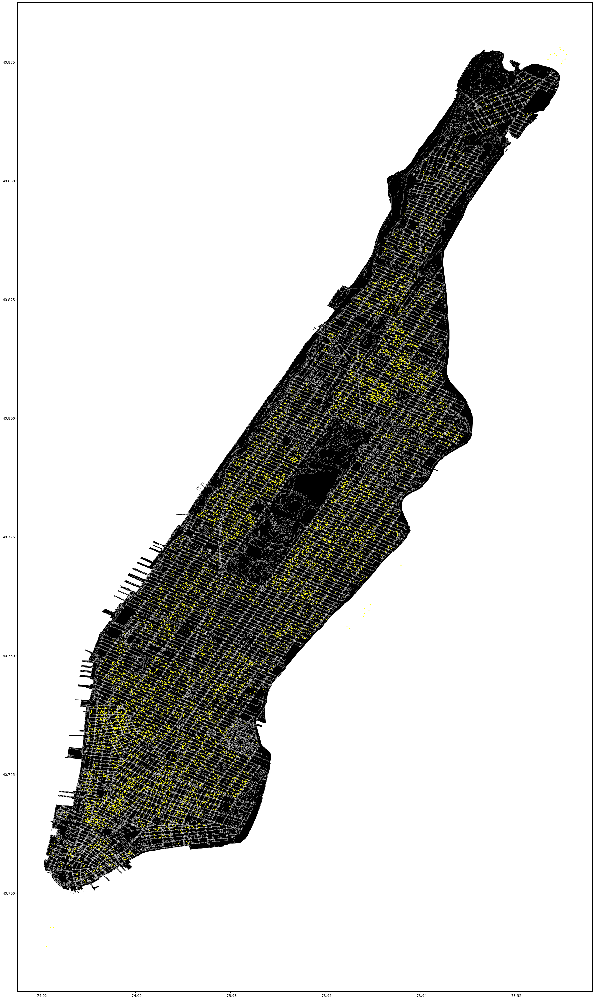

In [33]:
fig, ax = plt.subplots(figsize=(30,50),)
area.plot(ax = ax, facecolor = 'black')
edges.plot(ax = ax, linewidth = 0.2, edgecolor = 'white', facecolor = 'black')
nodes.plot(ax= ax, color = 'white', markersize = .1)
construction_points.plot(ax= ax, markersize = 3, color = 'yellow')

##### Option A: Assign Edges

In [34]:
close_edges = ox.distance.nearest_edges(G, construction_points['geometry'].x, construction_points['geometry'].y)
construction_count = Counter(close_edges)
new_construction = []

for i in edges.index:
    project = construction_count[edges.loc[i].name]
    new_construction.append(project)


edges['New Construction'] = new_construction

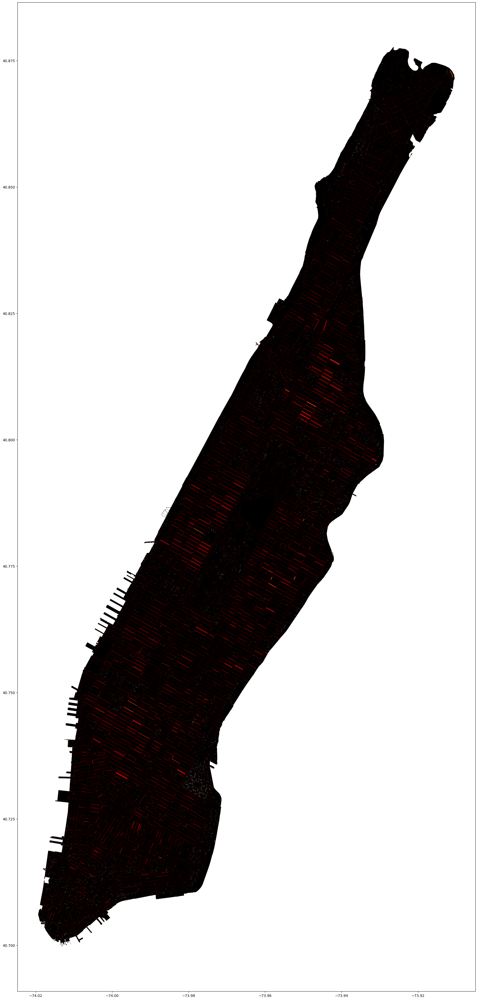

In [35]:
fig, ax = plt.subplots(figsize=(30,50))
area.plot(ax = ax, facecolor = 'black')
edges.plot(ax = ax, column = 'New Construction', cmap = 'hot', linewidth = 1.5)
nodes.plot(ax= ax, color = 'white', markersize = .1)
# property_gdf.plot(ax= ax,  markersize = 0.5, color = 'blue')

plt.show()

##### Option B: Assign Nodes

In [36]:
construction_boxes = place_boxes(construction_gdf['geometry'], .003)

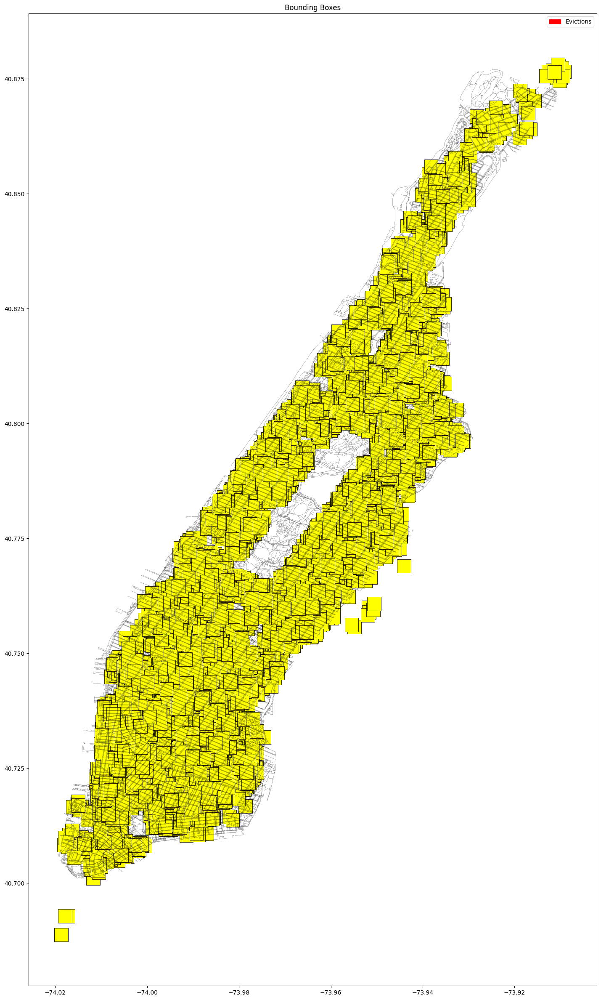

In [37]:
fig, ax = plt.subplots(figsize=(30,30))
#boundary.plot(ax=ax, facecolor='gray')
edges.plot(ax=ax, linewidth=0.1, edgecolor='black')
nodes.plot(ax=ax, color='black', markersize=0.0003)

construction_boxes.plot(ax=ax,facecolor='yellow',color="yellow", markersize=5, edgecolor="black", linewidth=0.6)

#create a legend
construction_patch = mpatches.Patch(color='yellow', label='Construction')

plt.legend(handles=[eviction_patch] )
ax.set_title("Bounding Boxes")
plt.show()

In [38]:
nodes_osmid=list(nodes.index)
Points_spatialindex=list(node_points.index) 

osmId_spatialIndex = {}
[osmId_spatialIndex.update({i:j}) for i,j in zip(Points_spatialindex ,nodes_osmid)]
len(nodes_osmid)

46537

In [39]:
nearest_points_spatial_index_construction =nodes.sindex.query(construction_boxes)
print(f'centroids and graph nodes spatial index - Construction {nearest_points_spatial_index_construction}')  #[0] first array is the indicies of each box and [1] the second array is the indicies of the included graph points
print(nearest_points_spatial_index_construction.shape)

centroids and graph nodes spatial index - Construction [[    0     0     0 ...  7941  7941  7941]
 [25487 44375 25441 ... 45697 15247 15246]]
(2, 574445)


In [40]:
construction_counter=Counter(nearest_points_spatial_index_construction[1])

points_selections={}
for i in tqdm(node_points.index):
  points_selections[i]=[]
  points_selections[i].append(construction_counter[i])

100%|██████████| 46537/46537 [00:00<00:00, 1555648.47it/s]


In [41]:
for i,j in zip(points_selections.keys(),points_selections.values()):
  if j[0]!=0:
    pass

In [42]:
nodes["construction"]= [i[0] for i in points_selections.values()]
nodes

,y,x,street_count,highway,ref,geometry,evictions,construction
osmid,,,,,,,,
30807314,40.790720,-73.963576,4,NaN,NaN,POINT (-73.96358 40.79072),0,0
30978752,40.774754,-73.974383,4,NaN,NaN,POINT (-73.97438 40.77475),0,0
42421728,40.798048,-73.960044,3,traffic_signals,NaN,POINT (-73.96004 40.79805),17,7
42421731,40.798654,-73.961474,4,traffic_signals,NaN,POINT (-73.96147 40.79865),29,17
42421737,40.799244,-73.962873,4,traffic_signals,NaN,POINT (-73.96287 40.79924),43,18
...,...,...,...,...,...,...,...,...
11987722733,40.733852,-74.001146,4,crossing,NaN,POINT (-74.00115 40.73385),10,33
11987722734,40.733791,-74.001256,4,NaN,NaN,POINT (-74.00126 40.73379),10,34
11987755568,40.866205,-73.927915,4,NaN,NaN,POINT (-73.92791 40.86620),40,4


#### FEATURE ANALYSIS

In [43]:
import phik
from phik.report import plot_correlation_matrix
from phik import report
import seaborn as sns
import warnings

##### Edge Data Analysis

In [44]:
edges.head()

osmid    highway  oneway reversed   length  \
u        v          key                                                   
30807314 2057103273 0     46613689  bridleway   False    False  159.255   
         6579409036 0     46613689  bridleway   False     True   58.144   
         1203806263 0    147089927       path   False    False   28.607   
         1203806304 0    147089927       path   False     True   17.645   
30978752 2059303879 0    301283866    footway   False    False   10.889   

                                                                  geometry  \
u        v          key                                                      
30807314 2057103273 0    LINESTRING (-73.96358 40.79072, -73.96360 40.7...   
         6579409036 0    LINESTRING (-73.96358 40.79072, -73.96354 40.7...   
         1203806263 0    LINESTRING (-73.96358 40.79072, -73.96353 40.7...   
         1203806304 0    LINESTRING (-73.96358 40.79072, -73.96368 40.7...   
30978752 2059303879 0    LINESTRING (-73.97438 40.77475, -73.97444 40.7...   

                        name maxspeed lanes access  ... width bridge junction  \
u        v          key                             ...                         
30807314 2057103273 0      0        0     0      0  ...     0      0        0   
         6579409036 0      0        0     0      0  ...     0      0        0   
         1203806263 0      0        0     0      0  ...     0      0        0   
         1203806304 0      0        0     0      0  ...     0      0        0   
30978752 2059303879 0      0        0     0      0  ...     0      0        0   

                        est_width area landuse evictions Average Value  \
u        v          key                                                  
30807314 2057103273 0           0    0       0         0           0.0   
         6579409036 0           0    0       0         0           0.0   
         1203806263 0           0    0       0         0           0.0   
         1203806304 0           0    0       0         0           0.0   
30978752 2059303879 0           0    0       0         0           0.0   

                        Scaled Value  New Construction  
u        v          key                                 
30807314 2057103273 0      -0.060462                 0  
         6579409036 0      -0.060462                 0  
         1203806263 0      -0.060462                 0  
         1203806304 0      -0.060462                 0  
30978752 2059303879 0      -0.060462                 0  

[5 rows x 23 columns]

interval columns not set, guessing: ['Scaled Value', 'evictions', 'New Construction']


Text(0.5, 1.0, 'Correlation Heatmap')

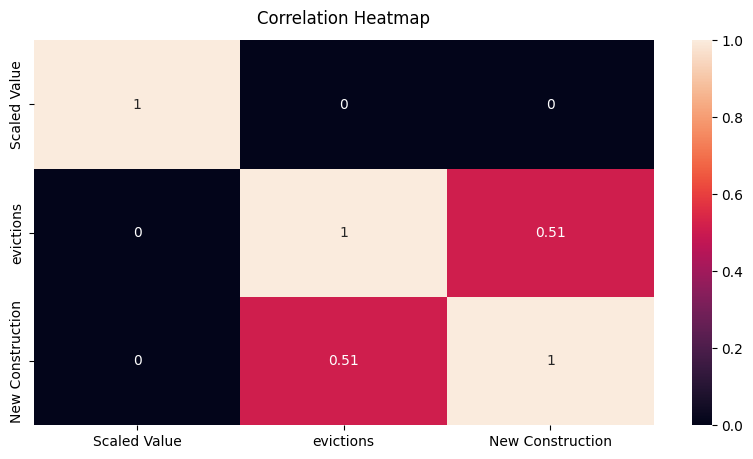

In [45]:
attributes_to_check = ['Scaled Value', 'evictions', 'New Construction']
data_to_check = edges[attributes_to_check]
warnings.filterwarnings("ignore")

plt.figure(figsize=(10, 5))
heatmap = sns.heatmap(data_to_check.phik_matrix(), annot=True)
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':12}, pad=12)

##### Node Data Analysis

interval columns not set, guessing: ['evictions', 'construction']


Text(0.5, 1.0, 'Correlation Heatmap')

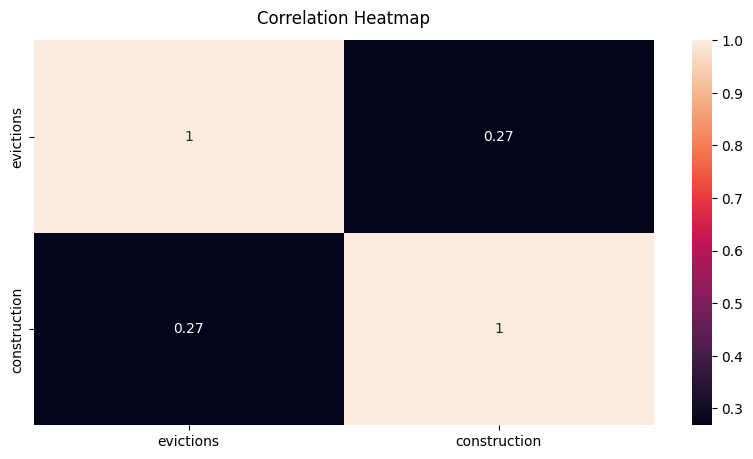

In [46]:
attributes_to_check = ['evictions' , 'construction']
data_to_check = nodes[attributes_to_check]
warnings.filterwarnings("ignore")

plt.figure(figsize=(10, 5))
heatmap = sns.heatmap(data_to_check.phik_matrix(), annot=True)
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':12}, pad=12)

# GML WITH EDGE DATA

#### ADD DATA TO NODES
Finds the average value of all connected edges for each node.

In [47]:
G_enriched = ox.graph_from_gdfs(nodes, edges)

In [48]:
edges.head()

osmid    highway  oneway reversed   length  \
u        v          key                                                   
30807314 2057103273 0     46613689  bridleway   False    False  159.255   
         6579409036 0     46613689  bridleway   False     True   58.144   
         1203806263 0    147089927       path   False    False   28.607   
         1203806304 0    147089927       path   False     True   17.645   
30978752 2059303879 0    301283866    footway   False    False   10.889   

                                                                  geometry  \
u        v          key                                                      
30807314 2057103273 0    LINESTRING (-73.96358 40.79072, -73.96360 40.7...   
         6579409036 0    LINESTRING (-73.96358 40.79072, -73.96354 40.7...   
         1203806263 0    LINESTRING (-73.96358 40.79072, -73.96353 40.7...   
         1203806304 0    LINESTRING (-73.96358 40.79072, -73.96368 40.7...   
30978752 2059303879 0    LINESTRING (-73.97438 40.77475, -73.97444 40.7...   

                        name maxspeed lanes access  ... width bridge junction  \
u        v          key                             ...                         
30807314 2057103273 0      0        0     0      0  ...     0      0        0   
         6579409036 0      0        0     0      0  ...     0      0        0   
         1203806263 0      0        0     0      0  ...     0      0        0   
         1203806304 0      0        0     0      0  ...     0      0        0   
30978752 2059303879 0      0        0     0      0  ...     0      0        0   

                        est_width area landuse evictions Average Value  \
u        v          key                                                  
30807314 2057103273 0           0    0       0         0           0.0   
         6579409036 0           0    0       0         0           0.0   
         1203806263 0           0    0       0         0           0.0   
         1203806304 0           0    0       0         0           0.0   
30978752 2059303879 0           0    0       0         0           0.0   

                        Scaled Value  New Construction  
u        v          key                                 
30807314 2057103273 0      -0.060462                 0  
         6579409036 0      -0.060462                 0  
         1203806263 0      -0.060462                 0  
         1203806304 0      -0.060462                 0  
30978752 2059303879 0      -0.060462                 0  

[5 rows x 23 columns]

In [49]:
for node in G_enriched.nodes():
    neighbors = list(G_enriched.neighbors(node))

    if len(neighbors) > 0:
    
        for neighbor in neighbors:

            neighbor_evictions=[]
            neighbor_value = []
            neighbor_construction = []

            neighbor_evictions.append(G_enriched.get_edge_data(node, neighbor)[0]['evictions'])
            neighbor_value.append(G_enriched.get_edge_data(node, neighbor)[0]['Average Value'])
            neighbor_value.append(G_enriched.get_edge_data(node, neighbor)[0]['New Construction'])

            length = len(neighbors)
            avg_evictions = sum(neighbor_evictions)
            avg_value = sum(neighbor_value)
            avg_construction = sum(neighbor_construction)

        G_enriched.nodes[node]['avg_evictions'] = avg_evictions
        G_enriched.nodes[node]['avg_value'] = avg_value
        G_enriched.nodes[node]['avg_construction'] = avg_construction

    else:
        G_enriched.nodes[node]['avg_evictions'] = 0
        G_enriched.nodes[node]['avg_value'] = 0
        G_enriched.nodes[node]['avg_construction'] = 0



In [50]:
nodes, edges = ox.graph_to_gdfs(G_enriched)
nodes['avg_evictions']

osmid
30807314       0
2057103273     0
6579409036     0
1203806263     0
1203806304     0
              ..
11986125253    0
11986195428    0
11986404590    0
11986404592    0
11986404591    0
Name: avg_evictions, Length: 46537, dtype: int64

#### SORT NODES BY NEIGHBORHOOD

In [51]:
from shapely.geometry import Point

neighborhood_data = open('./Data/Neighborhoods Boundries.geojson')
neighborhood_gdf = gpd.read_file(neighborhood_data)
neighborhood_gdf.to_crs(epsg = 4326)

manhatan_neighborhood_gdf = neighborhood_gdf[neighborhood_gdf['boroname'] == 'Manhattan']

In [52]:
unique_neighborhoods = manhatan_neighborhood_gdf['ntaname'].unique()
neighborhood_index = {neighborhood: idx for idx, neighborhood in enumerate(unique_neighborhoods)}

manhatan_neighborhood_gdf['neighborhood_index'] = manhatan_neighborhood_gdf['ntaname'].map(neighborhood_index)
manhatan_neighborhood_gdf.head()

,ntacode,shape_area,ntaname,shape_leng,boroname,borocode,countyfips,geometry,neighborhood_index
23,MN22,10895491.3668,East Village,13539.1976325,Manhattan,1,061,"MULTIPOLYGON (((-73.98256 40.73135, -73.98247 ...",0
26,MN32,13594779.7698,Yorkville,17409.2101147,Manhattan,1,061,"MULTIPOLYGON (((-73.93805 40.78083, -73.93790 ...",1
27,MN40,20065329.4877,Upper East Side-Carnegie Hill,23778.406402,Manhattan,1,061,"MULTIPOLYGON (((-73.94933 40.78519, -73.94982 ...",2
38,MN09,20158317.285,Morningside Heights,20744.3135549,Manhattan,1,061,"MULTIPOLYGON (((-73.95210 40.81144, -73.95259 ...",3
49,MN06,10647077.6941,Manhattanville,17040.6857307,Manhattan,1,061,"MULTIPOLYGON (((-73.94608 40.82126, -73.94640 ...",4


In [63]:
neighborhoods = []
for node, data in G_enriched.nodes(data=True):

    point = Point(data['x'], data['y'])

    for ind, shape in manhatan_neighborhood_gdf.iterrows():
        if shape['geometry'].contains(point):
            neighborhoods.append(shape['neighborhood_index'])

In [66]:
nodes['neighborhood'] = neighborhoods
nodes.head()

ValueError: Length of values (46435) does not match length of index (46537)

KeyError: 'neighborhood'

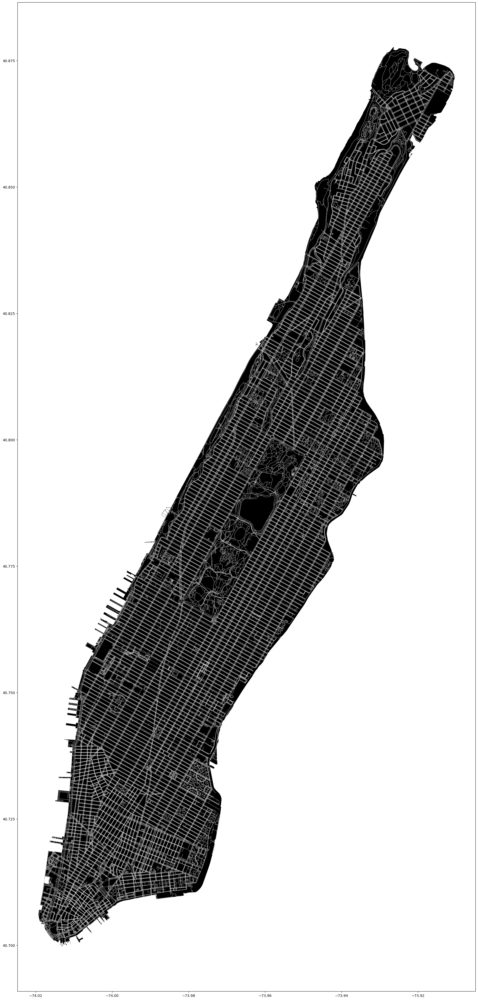

In [58]:
fig, ax = plt.subplots(figsize=(30,50))
area.plot(ax = ax, facecolor = 'black')
edges.plot(ax = ax,  linewidth = .3, color = 'white')
nodes.plot(ax= ax, column = 'neighborhood', cmap = 'hsv', markersize = 10)
# property_gdf.plot(ax= ax,  markersize = 0.5, color = 'blue')

### 3. ADD CLASSES
***

In [68]:
classes = []
for node in nodes['avg_evictions']:

    if node > 0 and node <= 5:
        classes.append(1)

    elif node > 5 and node <= 10:
        classes.append(2)
        
    elif node > 10 and node <= 15:
        classes.append(3)
    
    elif node > 15 and node <= 20:
        classes.append(4)
    
    elif node > 20:
        classes.append(5)
    else:
        classes.append(6)


nodes['class'] = classes
nodes.head()

,y,x,street_count,evictions,construction,avg_evictions,avg_value,avg_construction,highway,ref,geometry,class
osmid,,,,,,,,,,,,
30807314,40.790720,-73.963576,4,0,0,0,0.0,0,NaN,NaN,POINT (-73.96358 40.79072),6
2057103273,40.789389,-73.963831,4,0,0,0,0.0,0,NaN,NaN,POINT (-73.96383 40.78939),6
6579409036,40.791033,-73.963025,3,0,0,0,0.0,0,NaN,NaN,POINT (-73.96302 40.79103),6
1203806263,40.790646,-73.963260,3,0,0,0,0.0,0,NaN,NaN,POINT (-73.96326 40.79065),6
1203806304,40.790839,-73.963716,4,0,1,0,0.0,0,crossing,NaN,POINT (-73.96372 40.79084),6


### 4. SPLIT AND NORMALIZE

In [69]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

In [70]:
labeled_nodes = [i for i, j in zip(list(nodes.index), nodes['class']) if j != 6]
unlabeled_nodes = [i for i, j in zip(list(nodes.index), nodes['class']) if j == 6]

print(len(labeled_nodes))
print(len(unlabeled_nodes))

1095
45442


In [71]:
train_nodes, test_nodes = train_test_split(labeled_nodes, random_state= 1, test_size= .2)
train_nodes, validation_nodes = train_test_split(train_nodes, random_state= 1, test_size = .2)

prediction_nodes = unlabeled_nodes

print(len(train_nodes))
print(len(test_nodes))
print(len(validation_nodes))
print(len(prediction_nodes))

700
219
176
45442


In [72]:
nodes[['avg_evictions', 'avg_value', 'avg_construction']].loc[train_nodes]

,avg_evictions,avg_value,avg_construction
osmid,,,
3119952610,1,2.856266e+06,0
6270714182,1,3.537617e+06,0
7925143983,4,0.000000e+00,0
9561229762,5,8.488500e+05,0
42451375,5,0.000000e+00,0
...,...,...,...
60929261,1,0.000000e+00,0
7727569325,2,1.990440e+06,0
42432103,2,6.430472e+05,0


In [73]:
scaler = StandardScaler()

train_features_std = scaler.fit_transform(nodes[['avg_evictions', 'avg_value', 'avg_construction']].loc[train_nodes])
validation_features_std = scaler.fit_transform(nodes[['avg_evictions', 'avg_value', 'avg_construction']].loc[validation_nodes])
test_features_std = scaler.fit_transform(nodes[['avg_evictions', 'avg_value', 'avg_construction']].loc[test_nodes])
prediction_features_std = scaler.fit_transform(nodes[['avg_evictions', 'avg_value', 'avg_construction']].loc[prediction_nodes])                                       

In [74]:
for ind, norm_train in zip (train_nodes, train_features_std):
    nodes.loc[ind, 'evictions_norm'] = norm_train[0]
    nodes.loc[ind, 'value_norm'] = norm_train[1]
    nodes.loc[ind, 'construction_norm'] = norm_train[2]


for ind, norm_validation in zip (validation_nodes, validation_features_std):
    nodes.loc[ind, 'evictions_norm'] = norm_validation[0]
    nodes.loc[ind, 'value_norm'] = norm_validation[1]
    nodes.loc[ind, 'construction_norm'] = norm_validation[2]


for ind, norm_test in zip (test_nodes, test_features_std):
    nodes.loc[ind, 'evictions_norm'] = norm_test[0]
    nodes.loc[ind, 'value_norm'] = norm_test[1]
    nodes.loc[ind, 'construction_norm'] = norm_test[2]


for ind, norm_prediction in zip (prediction_nodes, prediction_features_std):
    nodes.loc[ind, 'evictions_norm'] = norm_prediction[0]
    nodes.loc[ind, 'value_norm'] = norm_prediction[1]
    nodes.loc[ind, 'construction_norm'] = norm_prediction[2]

In [75]:
nodes

,y,x,street_count,evictions,construction,avg_evictions,avg_value,avg_construction,highway,ref,geometry,class,evictions_norm,value_norm,construction_norm
osmid,,,,,,,,,,,,,,,
30807314,40.790720,-73.963576,4,0,0,0,0.0,0,NaN,NaN,POINT (-73.96358 40.79072),6,0.0,-0.066252,0.0
2057103273,40.789389,-73.963831,4,0,0,0,0.0,0,NaN,NaN,POINT (-73.96383 40.78939),6,0.0,-0.066252,0.0
6579409036,40.791033,-73.963025,3,0,0,0,0.0,0,NaN,NaN,POINT (-73.96302 40.79103),6,0.0,-0.066252,0.0
1203806263,40.790646,-73.963260,3,0,0,0,0.0,0,NaN,NaN,POINT (-73.96326 40.79065),6,0.0,-0.066252,0.0
1203806304,40.790839,-73.963716,4,0,1,0,0.0,0,crossing,NaN,POINT (-73.96372 40.79084),6,0.0,-0.066252,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11986125253,40.742578,-74.002527,1,16,17,0,0.0,0,NaN,1,POINT (-74.00253 40.74258),6,0.0,-0.066252,0.0
11986195428,40.805450,-73.959751,1,11,4,0,0.0,0,NaN,NaN,POINT (-73.95975 40.80545),6,0.0,-0.066252,0.0
11986404590,40.805093,-73.939774,3,15,22,0,0.0,0,NaN,NaN,POINT (-73.93977 40.80509),6,0.0,-0.066252,0.0


### 5. CREATE DGL GRAPH
***

In [129]:
eviction_dic = {}
value_dic = {}
construction_dic = {}
neighborhood_dic = {}

classes_dic = {}
gdf_order_dic = {}

for i, j in enumerate(G_enriched.nodes()):
    eviction_dic[j] = nodes['evictions_norm'].iloc[i]
    value_dic[j] = nodes['value_norm'].iloc[i]
    construction_dic[j] = nodes['construction_norm'].iloc[i]
    neighborhood_dic = nodes['neighborhood'].iloc[i]

    classes_dic[j] = nodes['class'].iloc[i]
    gdf_order_dic[j] = i


nx.set_node_attributes(G_enriched,eviction_dic,'evictions_norm')
nx.set_node_attributes(G_enriched,value_dic,'value_norm')
nx.set_node_attributes(G_enriched,construction_dic,'construction_norm')
nx.set_node_attributes(G_enriched,neighborhood_dic,'neighborhood')
nx.set_node_attributes(G_enriched,gdf_order_dic,'gdf_order')

nx.set_node_attributes(G_enriched,classes_dic,'classes')

In [ ]:
print(nx.get_node_attributes(G_enriched, "classes"))

{42421728: 1, 42435337: 6, 42421731: 1, 42432736: 6, 42437916: 6, 42432737: 1, 42421737: 6, 42437917: 1, 42421741: 1, 42432756: 1, 1061531654: 1, 42421745: 6, 42421749: 6, 11803957852: 1, 42421751: 6, 42431118: 2, 42432764: 6, 42421769: 6, 42443347: 6, 42421772: 1, 42442469: 1, 42421775: 6, 11655721345: 6, 42428653: 6, 42421776: 1, 42431024: 6, 42431019: 1, 42421778: 6, 42422592: 6, 42441587: 6, 42421783: 6, 42443522: 1, 42427782: 1, 42429174: 6, 8904913030: 6, 42421785: 2, 42421786: 1, 42443520: 1, 42421791: 1, 4814440062: 6, 42448930: 1, 42421800: 1, 42435308: 1, 42424851: 6, 42421803: 1, 42437300: 1, 42421806: 1, 42442475: 6, 42421809: 6, 11655721355: 6, 42428663: 6, 42421810: 6, 42431030: 6, 42431034: 6, 42421820: 6, 42437312: 6, 42441569: 6, 42421828: 1, 42430942: 1, 42430938: 6, 42421852: 1, 561035342: 2, 42442584: 6, 42438928: 2, 42421857: 1, 42421865: 6, 1506591534: 6, 42443181: 1, 1332860731: 6, 42421877: 6, 42421889: 1, 42437949: 6, 42432191: 6, 42430241: 1, 42421941: 6, 4242

In [ ]:
nodes_attributes_list=["x", "y", "evictions_norm", "value_norm", "construction_norm", "neighborhood", "gdf_order", "classes"]
graph=dgl.from_networkx(G_enriched, node_attrs=nodes_attributes_list)

In [ ]:
nodes_attributes_list[2:-2]

['evictions_norm', 'value_norm', 'construction_norm', 'neighborhood']

In [ ]:
for i in nodes_attributes_list:
  graph.ndata[i]=torch.reshape(graph.ndata[i],(graph.ndata[i].shape[0],1))

graph.ndata["feat"]=torch.cat([graph.ndata[i] for i in nodes_attributes_list[2:-2]] ,1)
graph.ndata["feat"]=graph.ndata["feat"].type(torch.float32)

In [ ]:
graph=dgl.add_reverse_edges(graph)

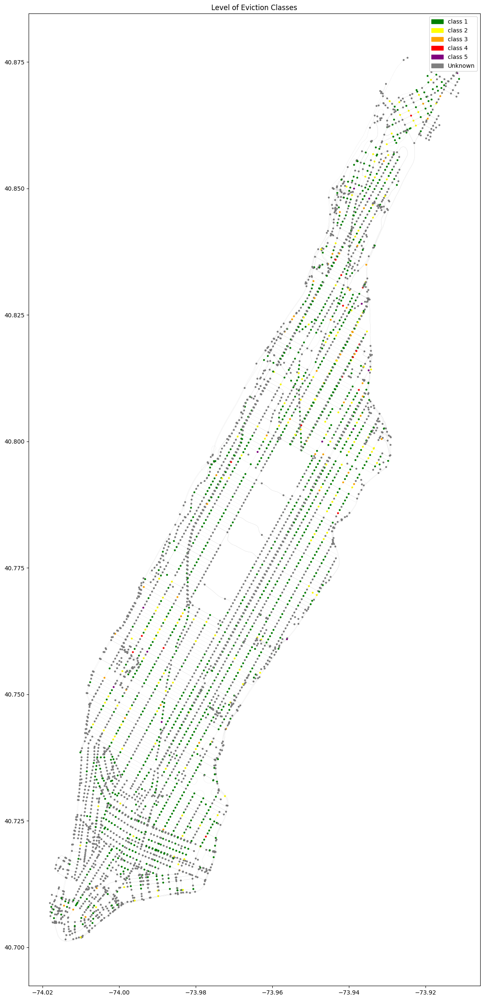

In [ ]:
fig, ax = plt.subplots(figsize=(30,30))
edges.plot(ax=ax, linewidth=0.03, edgecolor="black")
he_colors_dict={1:"green", 2:"yellow", 3:"orange", 4:"red", 5:"purple", 6:"gray"}
he_colors=[he_colors_dict[i] for i in nodes["class"] ]
nodes.plot( ax=ax, color=he_colors , markersize=5 , legend=True)
ax.set_title('Level of Eviction Classes')

#create a legend
c0 = mpatches.Patch(color=he_colors_dict[1], label='class 1')
c1 = mpatches.Patch(color=he_colors_dict[2], label='class 2')
c2 = mpatches.Patch(color=he_colors_dict[3], label='class 3')
c3 = mpatches.Patch(color=he_colors_dict[4], label='class 4')
c4 = mpatches.Patch(color=he_colors_dict[5], label='class 5')
c5 = mpatches.Patch(color=he_colors_dict[6], label='Unknown')

plt.legend(handles=[c0, c1, c2, c3, c4, c5] )

plt.show()

In [ ]:
from sklearn.model_selection import train_test_split

labeled_nodes=[i.numpy().item() for i,j in zip(graph.nodes(),graph.ndata["classes"]) if j != 6]
un_labeled_nodes=[i.numpy().item() for i,j in zip(graph.nodes(),graph.ndata["classes"]) if j == 6]

print(len(labeled_nodes))
print(len(un_labeled_nodes))

1432
3072


In [ ]:
train_nodes, test_nodes= train_test_split(labeled_nodes, random_state=1, test_size=.1) #test
train_nodes, validation_nodes= train_test_split(train_nodes, random_state=1, test_size=.11)      #validation

prediction_nodes=un_labeled_nodes

print(len(train_nodes))
print(len(test_nodes))
print(len(validation_nodes))
print(len(prediction_nodes))

1146
144
142
3072


In [ ]:
print(sorted(train_nodes))
train_mask={i.numpy().item() :False for i in graph.nodes()}
print(train_mask)
[train_mask.update({n:True}) for n in train_nodes]
print(train_mask)

[0, 1, 10, 13, 14, 15, 16, 17, 18, 22, 23, 24, 27, 42, 76, 91, 104, 105, 117, 141, 146, 159, 160, 163, 166, 167, 169, 172, 174, 175, 177, 181, 191, 197, 201, 202, 207, 215, 217, 219, 221, 226, 229, 230, 232, 234, 235, 236, 237, 238, 239, 242, 246, 248, 252, 253, 254, 255, 256, 258, 259, 260, 261, 263, 266, 276, 279, 280, 282, 286, 289, 290, 305, 306, 309, 310, 317, 318, 321, 322, 323, 326, 329, 331, 338, 346, 350, 352, 353, 362, 363, 364, 365, 380, 381, 392, 411, 420, 423, 426, 430, 453, 454, 455, 459, 472, 474, 480, 487, 488, 495, 497, 499, 500, 503, 504, 505, 529, 530, 534, 536, 539, 548, 549, 552, 558, 564, 569, 574, 585, 587, 588, 603, 608, 609, 616, 621, 631, 633, 635, 636, 650, 654, 660, 662, 663, 671, 672, 674, 675, 676, 677, 681, 688, 690, 696, 702, 704, 706, 707, 710, 712, 725, 738, 747, 753, 767, 774, 776, 777, 778, 783, 784, 791, 797, 798, 800, 801, 802, 808, 809, 810, 814, 815, 824, 825, 826, 827, 829, 830, 831, 832, 833, 834, 842, 843, 844, 847, 859, 860, 863, 864, 865, 88

In [ ]:
print(sorted(validation_nodes))
validation_mask={i.numpy().item() :False for i in graph.nodes()}
[validation_mask.update({n:True}) for n in validation_nodes]
print(validation_mask)

[3, 37, 65, 161, 257, 291, 302, 325, 337, 343, 344, 349, 413, 428, 438, 484, 489, 513, 537, 649, 670, 726, 769, 770, 799, 822, 828, 849, 855, 888, 897, 1005, 1070, 1075, 1128, 1143, 1150, 1184, 1192, 1244, 1263, 1282, 1285, 1297, 1313, 1358, 1390, 1412, 1414, 1483, 1490, 1529, 1542, 1547, 1609, 1613, 1616, 1631, 1683, 1689, 1732, 1733, 1758, 1799, 1829, 1873, 1917, 1923, 1945, 1964, 1966, 1971, 1976, 1998, 2019, 2023, 2034, 2105, 2113, 2204, 2208, 2211, 2212, 2237, 2244, 2249, 2263, 2279, 2289, 2348, 2366, 2402, 2420, 2514, 2551, 2557, 2563, 2564, 2599, 2626, 2634, 2680, 2687, 2715, 2752, 2789, 2798, 2802, 2828, 2834, 2872, 3019, 3285, 3384, 3424, 3441, 3519, 3668, 3675, 3695, 3715, 3838, 3852, 3855, 3868, 3884, 3900, 3906, 3958, 3962, 3965, 4034, 4082, 4103, 4109, 4154, 4157, 4255, 4272, 4345, 4369, 4431]
{0: False, 1: False, 2: False, 3: True, 4: False, 5: False, 6: False, 7: False, 8: False, 9: False, 10: False, 11: False, 12: False, 13: False, 14: False, 15: False, 16: False, 17: F

In [ ]:
print(sorted(test_nodes))
test_mask={i.numpy().item() :False for i in graph.nodes()}
[test_mask.update({n:True}) for n in test_nodes]
print(test_mask)

[8, 87, 180, 222, 223, 241, 285, 307, 313, 335, 341, 348, 351, 612, 620, 651, 683, 701, 744, 862, 901, 909, 942, 943, 991, 998, 1009, 1042, 1077, 1139, 1151, 1153, 1225, 1232, 1257, 1268, 1292, 1322, 1353, 1375, 1386, 1395, 1460, 1509, 1515, 1541, 1556, 1557, 1588, 1623, 1666, 1673, 1697, 1718, 1849, 1856, 1868, 1877, 1891, 1946, 1970, 1979, 2033, 2091, 2136, 2141, 2221, 2252, 2264, 2278, 2291, 2328, 2336, 2340, 2393, 2412, 2429, 2434, 2447, 2509, 2511, 2515, 2517, 2550, 2554, 2566, 2573, 2594, 2607, 2661, 2665, 2666, 2704, 2787, 2788, 2790, 2793, 2820, 2850, 2874, 2890, 2893, 2897, 2899, 2908, 2922, 2970, 2989, 3003, 3015, 3027, 3028, 3046, 3062, 3075, 3077, 3091, 3179, 3260, 3290, 3404, 3421, 3435, 3516, 3530, 3547, 3600, 3624, 3783, 3806, 3820, 3829, 3892, 3902, 3974, 4006, 4175, 4204, 4225, 4250, 4276, 4289, 4383, 4476]
{0: False, 1: False, 2: False, 3: False, 4: False, 5: False, 6: False, 7: False, 8: True, 9: False, 10: False, 11: False, 12: False, 13: False, 14: False, 15: False

In [ ]:
print(sorted(prediction_nodes))
prediction_mask={i.numpy().item() :False for i in graph.nodes()}
[prediction_mask.update({n:True}) for n in prediction_nodes]
print(prediction_mask)

[2, 4, 5, 6, 7, 9, 11, 12, 19, 20, 21, 25, 26, 28, 29, 30, 31, 32, 33, 34, 35, 36, 38, 39, 40, 41, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 88, 89, 90, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 142, 143, 144, 145, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 162, 164, 165, 168, 170, 171, 173, 176, 178, 179, 182, 183, 184, 185, 186, 187, 188, 189, 190, 192, 193, 194, 195, 196, 198, 199, 200, 203, 204, 205, 206, 208, 209, 210, 211, 212, 213, 214, 216, 218, 220, 224, 225, 227, 228, 231, 233, 240, 243, 244, 245, 247, 249, 250, 251, 262, 264, 265, 267, 268, 269, 270, 271, 272, 273, 274, 275, 277, 278, 281, 283, 284, 287, 288, 292, 293, 294, 295, 296, 297, 298, 299, 300, 301,

In [ ]:
reorder_dict={}
for i,j in enumerate([o.numpy().item() for o in graph.ndata["gdf_order"]]):
  reorder_dict[j]=i
print(reorder_dict)

{0: 0, 2: 1, 6: 2, 8: 3, 11: 4, 12: 5, 14: 6, 17: 7, 19: 8, 21: 9, 24: 10, 27: 11, 30: 12, 35: 13, 36: 14, 38: 15, 41: 16, 44: 17, 46: 18, 48: 19, 51: 20, 54: 21, 57: 22, 60: 23, 64: 24, 65: 25, 69: 26, 70: 27, 74: 28, 77: 29, 78: 30, 75: 31, 80: 32, 84: 33, 86: 34, 89: 35, 91: 36, 94: 37, 98: 38, 99: 39, 102: 40, 106: 41, 107: 42, 109: 43, 114: 44, 118: 45, 120: 46, 122: 47, 123: 48, 125: 49, 129: 50, 130: 51, 132: 52, 134: 53, 136: 54, 139: 55, 144: 56, 146: 57, 147: 58, 28: 59, 151: 60, 154: 61, 158: 62, 160: 63, 163: 64, 164: 65, 168: 66, 171: 67, 173: 68, 172: 69, 178: 70, 181: 71, 183: 72, 185: 73, 187: 74, 188: 75, 190: 76, 191: 77, 196: 78, 199: 79, 203: 80, 206: 81, 208: 82, 210: 83, 209: 84, 213: 85, 216: 86, 219: 87, 223: 88, 227: 89, 229: 90, 231: 91, 232: 92, 235: 93, 238: 94, 242: 95, 245: 96, 247: 97, 249: 98, 251: 99, 246: 100, 256: 101, 261: 102, 264: 103, 265: 104, 248: 105, 270: 106, 271: 107, 274: 108, 275: 109, 279: 110, 281: 111, 283: 112, 285: 113, 287: 114, 290:

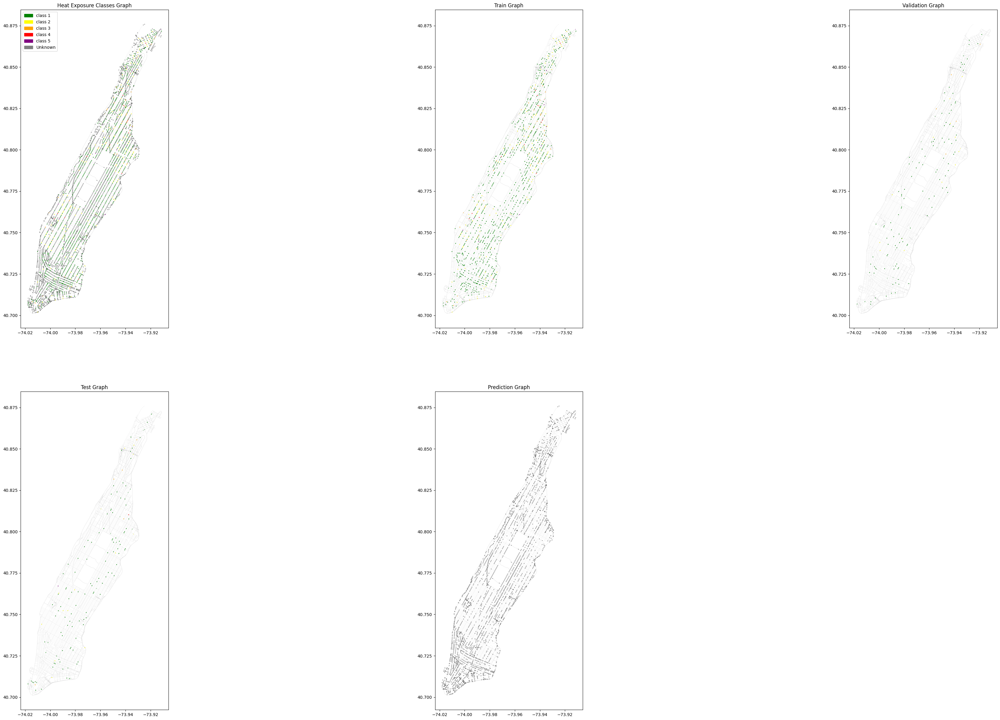

In [ ]:
fig = plt.figure(figsize=(50,30))
he_colors_dict={1:"green", 2:"yellow", 3:"orange", 4:"red", 5:"purple", 6:"gray"}
classes_list=[t[0] for t in graph.ndata["classes"].tolist()]
classes_list_reordered=[classes_list[reorder_dict[i]] for i in sorted(reorder_dict.keys())]

out_of_mask_color="white"

# Graph
ax = fig.add_subplot(2,3,1)
edges.plot(ax=ax, linewidth=0.03, edgecolor="black")
he_colors=[he_colors_dict[i] for i in nodes["class"]]
nodes.plot(ax=ax, color=he_colors , markersize=0.6 , legend=True)
ax.set_title('Eviction Classes Graph')

c0 = mpatches.Patch(color=he_colors_dict[1], label='class 1')
c1 = mpatches.Patch(color=he_colors_dict[2], label='class 2')
c2 = mpatches.Patch(color=he_colors_dict[3], label='class 3')
c3 = mpatches.Patch(color=he_colors_dict[4], label='class 4')
c4 = mpatches.Patch(color=he_colors_dict[5], label='class 5')
c5 = mpatches.Patch(color=he_colors_dict[6], label='Unknown')

plt.legend(handles=[c0, c1, c2, c3, c4, c5] )

#Train mask
ax = fig.add_subplot(2,3,2)
edges.plot(ax=ax, linewidth=0.03, edgecolor="black")

train_colors=[he_colors_dict[j] if train_mask[reorder_dict[i]]==True else out_of_mask_color for i,j in enumerate(classes_list_reordered) ] #dont use nodes["classes"] since the nodes order changed in dgl graph
nodes.plot(ax=ax, color=train_colors , markersize=0.6 , legend=True)
ax.set_title('Train Graph')

#Validation mask
ax = fig.add_subplot(2,3,3)
edges.plot(ax=ax, linewidth=0.03, edgecolor="black")

validation_colors=[he_colors_dict[j] if validation_mask[reorder_dict[i]]==True else out_of_mask_color for i,j in enumerate(classes_list_reordered) ]
nodes.plot(ax=ax, color=validation_colors , markersize=0.6 , legend=True)
ax.set_title('Validation Graph')

#Test mask
ax = fig.add_subplot(2,3,4)
edges.plot(ax=ax, linewidth=0.03, edgecolor="black")

test_colors=[he_colors_dict[j] if test_mask[reorder_dict[i]]==True else out_of_mask_color for i,j in enumerate(classes_list_reordered) ]
nodes.plot(ax=ax, color=test_colors , markersize=0.6 , legend=True)
ax.set_title('Test Graph')

#prediction mask
ax = fig.add_subplot(2,3,5)
edges.plot(ax=ax, linewidth=0.03, edgecolor="black")

prediction_colors=[he_colors_dict[j] if prediction_mask[reorder_dict[i]]==True else out_of_mask_color for i,j in enumerate(classes_list_reordered) ]
nodes.plot(ax=ax, color=prediction_colors , markersize=0.6 , legend=True)
ax.set_title('Prediction Graph')

plt.show()

In [ ]:
graph.ndata["train_mask"]=torch.tensor(list(train_mask.values()))
graph.ndata["validation_mask"]=torch.tensor(list(validation_mask.values()))
graph.ndata["test_mask"]=torch.tensor(list(test_mask.values()))
graph.ndata["prediction_mask"]=torch.tensor(list(prediction_mask.values()))

In [ ]:
class SAGE(nn.Module):
    def __init__(self, in_feats, hid_feats, out_feats):
        super().__init__()
        self.conv1 = SAGEConv(in_feats=in_feats, out_feats=hid_feats, aggregator_type='mean')
        self.conv2 = SAGEConv(in_feats=hid_feats, out_feats=out_feats, aggregator_type='mean')

    def forward(self, graph, inputs):
        # inputs are features of nodes
        h = self.conv1(graph, inputs)
        h = F.relu(h)
        h = self.conv2(graph, h)
        return h

In [ ]:
n_features=graph.ndata["feat"].shape[1]
classes_list=[t[0] for t in graph.ndata["classes"].tolist()]
n_labels=len(Counter(classes_list).keys())

In [ ]:
n_hidden=16
lr=0.03
n_epochs=200
device='cuda'

In [ ]:
model = SAGE(in_feats=n_features, hid_feats=n_hidden, out_feats=n_labels)
optimizer = torch.optim.Adam(model.parameters(), lr=lr)
model_path="walk-edges"
torch.manual_seed(710)
best_val_acc = 0
best_test_acc = 0

features = graph.ndata['feat']
labels = graph.ndata['classes']
train_mask_1 = graph.ndata['train_mask']
val_mask_1 = graph.ndata['validation_mask']
test_mask_1 = graph.ndata['test_mask']

train_accs=[]
valid_accs=[]

for e in range(n_epochs):
    # Forward
    logits = model(graph, features)

    # Compute prediction
    pred = logits.argmax(1)

    # Compute loss
    # Note that you should only compute the losses of the nodes in the training set.
    loss = F.cross_entropy(logits[train_mask_1], labels[train_mask_1].squeeze())

    # Compute accuracy on training/validation/test
    train_acc = (pred[train_mask_1] == labels[train_mask_1]).float().mean()
    val_acc = (pred[val_mask_1] == labels[val_mask_1]).float().mean()
    # test_acc = (pred[test_mask_1] == labels[test_mask_1]).float().mean()

    train_accs.append(train_acc)
    valid_accs.append(val_acc)

    # Save the best validation accuracy and the corresponding test accuracy.
    if best_val_acc < val_acc:
        best_val_acc = val_acc
        torch.save(model.state_dict(), model_path)

    # Backward
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

    print('In epoch {}, loss: {:.3f}, train acc: {:.3f}, val acc: {:.3f}'.format(e, loss, train_acc, val_acc))

In epoch 0, loss: 4.169, train acc: 0.810, val acc: 0.866
In epoch 1, loss: 11.571, train acc: 0.044, val acc: 0.036
In epoch 2, loss: 9.137, train acc: 0.120, val acc: 0.099
In epoch 3, loss: 2.493, train acc: 0.809, val acc: 0.855
In epoch 4, loss: 3.856, train acc: 0.812, val acc: 0.866
In epoch 5, loss: 4.584, train acc: 0.812, val acc: 0.866
In epoch 6, loss: 4.945, train acc: 0.811, val acc: 0.866
In epoch 7, loss: 4.934, train acc: 0.810, val acc: 0.866
In epoch 8, loss: 4.682, train acc: 0.809, val acc: 0.866
In epoch 9, loss: 4.282, train acc: 0.800, val acc: 0.866
In epoch 10, loss: 4.256, train acc: 0.668, val acc: 0.756
In epoch 11, loss: 3.432, train acc: 0.766, val acc: 0.830
In epoch 12, loss: 2.791, train acc: 0.793, val acc: 0.866
In epoch 13, loss: 2.174, train acc: 0.798, val acc: 0.866
In epoch 14, loss: 1.891, train acc: 0.738, val acc: 0.823
In epoch 15, loss: 1.796, train acc: 0.568, val acc: 0.649
In epoch 16, loss: 2.360, train acc: 0.128, val acc: 0.104
In epo

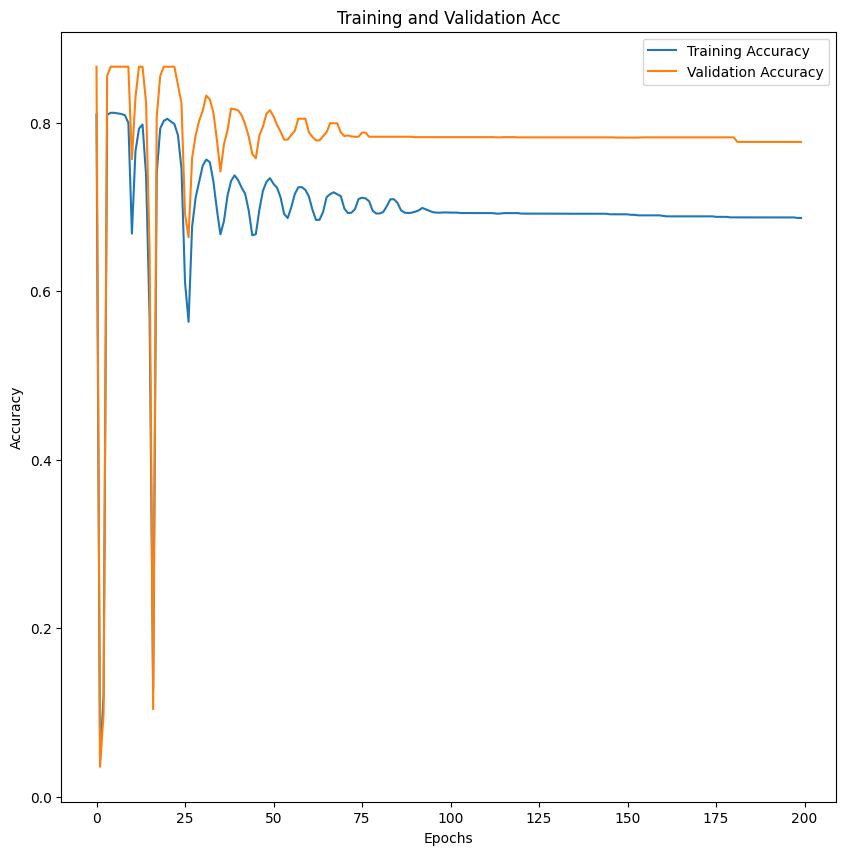

In [ ]:
%matplotlib inline
fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(1,1,1)

plt.plot(range(n_epochs), [a.numpy().item() for a in train_accs], label='Training Accuracy')
plt.plot(range(n_epochs), [a.numpy().item() for a in valid_accs], label='Validation Accuracy')

# Add in a title and axes labels
plt.title('Training and Validation Acc')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')

# Display the plot
plt.legend(loc='best')
plt.show()

In [ ]:
reorder_dict={}
for i,j in enumerate([o.numpy().item() for o in graph.ndata["gdf_order"]]):
  reorder_dict[j]=i
print(reorder_dict)

{0: 0, 2: 1, 6: 2, 8: 3, 11: 4, 12: 5, 14: 6, 17: 7, 19: 8, 21: 9, 24: 10, 27: 11, 30: 12, 35: 13, 36: 14, 38: 15, 41: 16, 44: 17, 46: 18, 48: 19, 51: 20, 54: 21, 57: 22, 60: 23, 64: 24, 65: 25, 69: 26, 70: 27, 74: 28, 77: 29, 78: 30, 75: 31, 80: 32, 84: 33, 86: 34, 89: 35, 91: 36, 94: 37, 98: 38, 99: 39, 102: 40, 106: 41, 107: 42, 109: 43, 114: 44, 118: 45, 120: 46, 122: 47, 123: 48, 125: 49, 129: 50, 130: 51, 132: 52, 134: 53, 136: 54, 139: 55, 144: 56, 146: 57, 147: 58, 28: 59, 151: 60, 154: 61, 158: 62, 160: 63, 163: 64, 164: 65, 168: 66, 171: 67, 173: 68, 172: 69, 178: 70, 181: 71, 183: 72, 185: 73, 187: 74, 188: 75, 190: 76, 191: 77, 196: 78, 199: 79, 203: 80, 206: 81, 208: 82, 210: 83, 209: 84, 213: 85, 216: 86, 219: 87, 223: 88, 227: 89, 229: 90, 231: 91, 232: 92, 235: 93, 238: 94, 242: 95, 245: 96, 247: 97, 249: 98, 251: 99, 246: 100, 256: 101, 261: 102, 264: 103, 265: 104, 248: 105, 270: 106, 271: 107, 274: 108, 275: 109, 279: 110, 281: 111, 283: 112, 285: 113, 287: 114, 290:

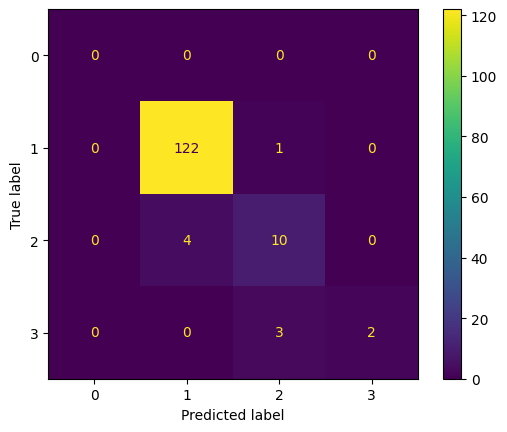

In [ ]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

y_test= labels[test_mask_1]
predictions = pred[test_mask_1]
cm = confusion_matrix(y_test, predictions, labels=[0,1,2,3])
disp = ConfusionMatrixDisplay(confusion_matrix=cm,display_labels=[0,1,2,3])
disp.plot()
plt.show()

In [ ]:
Counter([t[0] for t in graph.ndata["classes"].tolist()])

Counter({1: 1176, 6: 3072, 2: 166, 4: 17, 3: 60, 5: 13})

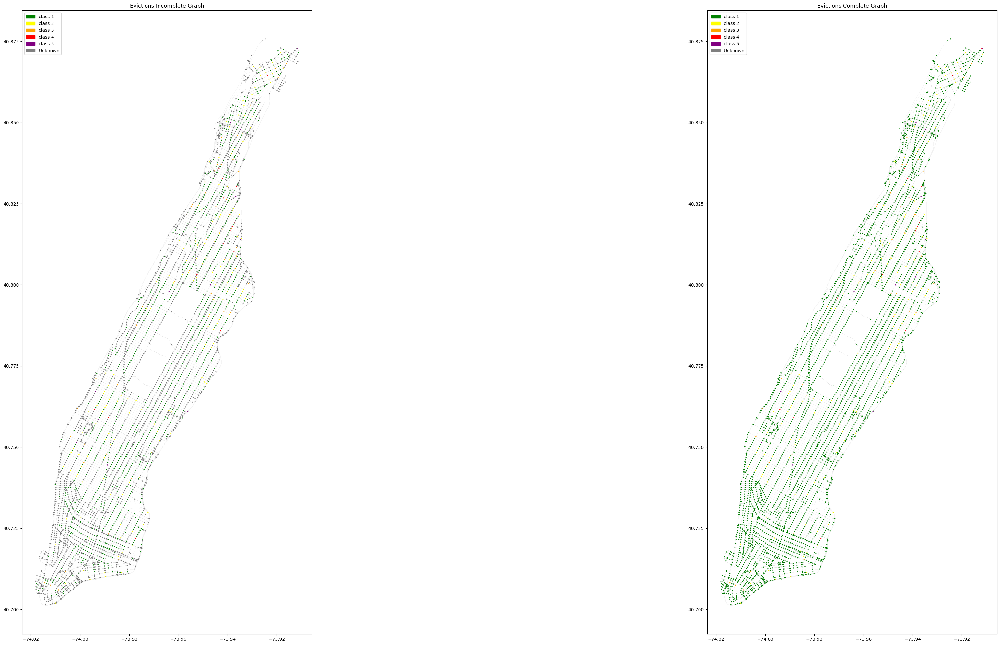

In [ ]:
fig = plt.figure(figsize=(30,25))
he_colors_dict={1:"green", 2:"yellow", 3:"orange", 4:"red", 5:"purple", 6:"gray"}
g_nodes=[n.numpy().item() for n in graph.nodes()]

#in osmnx order for visualization
classes_list=[t[0] for t in graph.ndata["classes"].tolist()]
classes_list_reordered=[classes_list[reorder_dict[i]] for i in sorted(reorder_dict.keys())]

classes_predicted_list=[i.numpy().item() for i in pred]
classes_predicted_list_reordered=[classes_predicted_list[reorder_dict[i]] for i in sorted(reorder_dict.keys())]

out_of_mask_color="white"

# Graph
ax = fig.add_subplot(1,2,1)
edges.plot(ax=ax, linewidth=0.03, edgecolor="black")
he_colors=[he_colors_dict[i] for i in classes_list_reordered]
nodes.plot(ax=ax, color=he_colors , markersize=2 , legend=True)
ax.set_title('Evictions Incomplete Graph')

c0 = mpatches.Patch(color=he_colors_dict[1], label='class 1')
c1 = mpatches.Patch(color=he_colors_dict[2], label='class 2')
c2 = mpatches.Patch(color=he_colors_dict[3], label='class 3')
c3 = mpatches.Patch(color=he_colors_dict[4], label='class 4')
c4 = mpatches.Patch(color=he_colors_dict[5], label='class 5')
c5 = mpatches.Patch(color=he_colors_dict[6], label='Unknown')

plt.legend(handles=[c0, c1, c2, c3, c4, c5] )


#prediction mask
ax = fig.add_subplot(1,2,2)
edges.plot(ax=ax, linewidth=0.03, edgecolor="black")

#notice it is not prediction_mask[i], but prediction_mask[reorder_dict[i]].. always pay attention to the data structre
prediction_colors=[he_colors_dict[j] if prediction_mask[reorder_dict[i]]==True else he_colors_dict[k] for i,(j,k) in enumerate(zip(classes_predicted_list_reordered,classes_list_reordered))] #j predicte class that we don't know, k is real class that we already know
nodes.plot(ax=ax, color=prediction_colors , markersize=2 , legend=True)
ax.set_title('Evictions Complete Graph')

c0 = mpatches.Patch(color=he_colors_dict[1], label='class 1')
c1 = mpatches.Patch(color=he_colors_dict[2], label='class 2')
c2 = mpatches.Patch(color=he_colors_dict[3], label='class 3')
c3 = mpatches.Patch(color=he_colors_dict[4], label='class 4')
c4 = mpatches.Patch(color=he_colors_dict[5], label='class 5')
c5 = mpatches.Patch(color=he_colors_dict[6], label='Unknown')

plt.legend(handles=[c0, c1, c2, c3, c4, c5] )
plt.show()

# GML WITH NODE DATA

#### SORT NODES BY NEIGHBORHOOD

In [77]:
from shapely.geometry import Point

neighborhood_data = open('./Data/Neighborhoods Boundries.geojson')
neighborhood_gdf = gpd.read_file(neighborhood_data)
neighborhood_gdf.set_crs(epsg = 4326)

manhatan_neighborhood_gdf = neighborhood_gdf[neighborhood_gdf['boroname'] == 'Manhattan']

In [78]:
unique_neighborhoods = manhatan_neighborhood_gdf['ntaname'].unique()
neighborhood_index = {neighborhood: idx for idx, neighborhood in enumerate(unique_neighborhoods)}

manhatan_neighborhood_gdf['neighborhood_index'] = manhatan_neighborhood_gdf['ntaname'].map(neighborhood_index)
manhatan_neighborhood_gdf.head()

,ntacode,shape_area,ntaname,shape_leng,boroname,borocode,countyfips,geometry,neighborhood_index
23,MN22,10895491.3668,East Village,13539.1976325,Manhattan,1,061,"MULTIPOLYGON (((-73.98256 40.73135, -73.98247 ...",0
26,MN32,13594779.7698,Yorkville,17409.2101147,Manhattan,1,061,"MULTIPOLYGON (((-73.93805 40.78083, -73.93790 ...",1
27,MN40,20065329.4877,Upper East Side-Carnegie Hill,23778.406402,Manhattan,1,061,"MULTIPOLYGON (((-73.94933 40.78519, -73.94982 ...",2
38,MN09,20158317.285,Morningside Heights,20744.3135549,Manhattan,1,061,"MULTIPOLYGON (((-73.95210 40.81144, -73.95259 ...",3
49,MN06,10647077.6941,Manhattanville,17040.6857307,Manhattan,1,061,"MULTIPOLYGON (((-73.94608 40.82126, -73.94640 ...",4


In [91]:
neighborhoods = []
for node, data in G_enriched.nodes(data=True):

    point = Point(data['x'], data['y'])

    has_val = False
    for ind, shape in manhatan_neighborhood_gdf.iterrows():
        if shape['geometry'].contains(point):
            neighborhoods.append(shape['neighborhood_index'])
            has_val = True

    if not(has_val):
        neighborhoods.append(0)
    
    

In [93]:
print(len(neighborhoods))
print(len(nodes))

46537
46537


In [94]:
nodes['neighborhood'] = neighborhoods
nodes.head()

,y,x,street_count,evictions,construction,avg_evictions,avg_value,avg_construction,highway,ref,geometry,class,evictions_norm,value_norm,construction_norm,neighborhood
osmid,,,,,,,,,,,,,,,,
30807314,40.790720,-73.963576,4,0,0,0,0.0,0,NaN,NaN,POINT (-73.96358 40.79072),6,0.0,-0.066252,0.0,25
2057103273,40.789389,-73.963831,4,0,0,0,0.0,0,NaN,NaN,POINT (-73.96383 40.78939),6,0.0,-0.066252,0.0,25
6579409036,40.791033,-73.963025,3,0,0,0,0.0,0,NaN,NaN,POINT (-73.96302 40.79103),6,0.0,-0.066252,0.0,25
1203806263,40.790646,-73.963260,3,0,0,0,0.0,0,NaN,NaN,POINT (-73.96326 40.79065),6,0.0,-0.066252,0.0,25
1203806304,40.790839,-73.963716,4,0,1,0,0.0,0,crossing,NaN,POINT (-73.96372 40.79084),6,0.0,-0.066252,0.0,25


<Axes: >

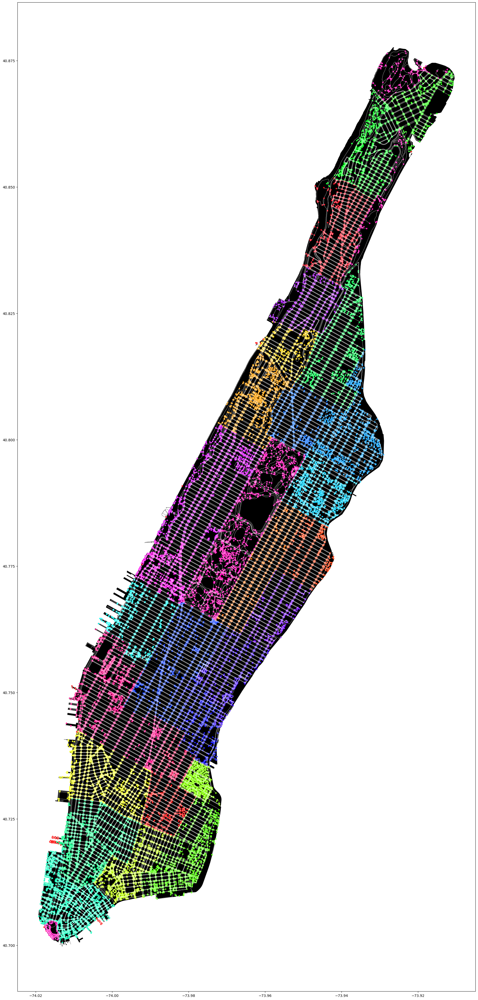

In [95]:
fig, ax = plt.subplots(figsize=(30,50))
area.plot(ax = ax, facecolor = 'black')
edges.plot(ax = ax,  linewidth = .3, color = 'white')
nodes.plot(ax= ax, column = 'neighborhood', cmap = 'hsv', markersize = 10)
# property_gdf.plot(ax= ax,  markersize = 0.5, color = 'blue')

#### ADD CLASSES

(array([1.4007e+04, 1.0241e+04, 7.8130e+03, 4.4230e+03, 3.1700e+03,
        2.1140e+03, 1.3520e+03, 1.1480e+03, 6.5200e+02, 4.2700e+02,
        3.5000e+02, 2.3700e+02, 2.2800e+02, 7.7000e+01, 8.4000e+01,
        7.5000e+01, 4.5000e+01, 6.3000e+01, 2.1000e+01, 1.0000e+01]),
 array([  0. ,   7.7,  15.4,  23.1,  30.8,  38.5,  46.2,  53.9,  61.6,
         69.3,  77. ,  84.7,  92.4, 100.1, 107.8, 115.5, 123.2, 130.9,
        138.6, 146.3, 154. ]),
 <BarContainer object of 20 artists>)

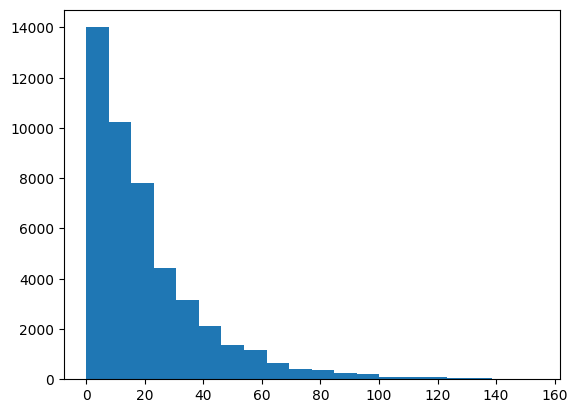

In [96]:
plt.hist(nodes['evictions'], bins  = 20)

In [97]:
classes = []
for node in nodes['evictions']:

    if node > 0 and node <= 20:
        classes.append(1)

    elif node > 20 and node <= 40:
        classes.append(2)
        
    elif node > 40 and node <= 60:
        classes.append(3)
    
    elif node > 60 and node <= 80:
        classes.append(4)
    
    elif node > 80:
        classes.append(5)
    else:
        classes.append(6)


nodes['class'] = classes
nodes.head()

,y,x,street_count,evictions,construction,avg_evictions,avg_value,avg_construction,highway,ref,geometry,class,evictions_norm,value_norm,construction_norm,neighborhood
osmid,,,,,,,,,,,,,,,,
30807314,40.790720,-73.963576,4,0,0,0,0.0,0,NaN,NaN,POINT (-73.96358 40.79072),6,0.0,-0.066252,0.0,25
2057103273,40.789389,-73.963831,4,0,0,0,0.0,0,NaN,NaN,POINT (-73.96383 40.78939),6,0.0,-0.066252,0.0,25
6579409036,40.791033,-73.963025,3,0,0,0,0.0,0,NaN,NaN,POINT (-73.96302 40.79103),6,0.0,-0.066252,0.0,25
1203806263,40.790646,-73.963260,3,0,0,0,0.0,0,NaN,NaN,POINT (-73.96326 40.79065),6,0.0,-0.066252,0.0,25
1203806304,40.790839,-73.963716,4,0,1,0,0.0,0,crossing,NaN,POINT (-73.96372 40.79084),6,0.0,-0.066252,0.0,25


#### 4. SPLIT AND NORMALIZE

In [98]:
labeled_nodes = [i for i, j in zip(list(nodes.index), nodes['class']) if j != 6]
unlabeled_nodes = [i for i, j in zip(list(nodes.index), nodes['class']) if j == 6]

print(len(labeled_nodes))
print(len(unlabeled_nodes))

42844
3693


In [99]:
train_nodes, test_nodes = train_test_split(labeled_nodes, random_state= 1, test_size= .2)
train_nodes, validation_nodes = train_test_split(train_nodes, random_state= 1, test_size = .2)

prediction_nodes = unlabeled_nodes

print(len(train_nodes))
print(len(test_nodes))
print(len(validation_nodes))
print(len(prediction_nodes))

27420
8569
6855
3693


In [100]:
test_values = ['evictions','construction']

In [101]:
nodes[test_values].loc[train_nodes]

,evictions,construction
osmid,,
10165922705,4,3
7925258569,14,0
7443830067,7,35
5163687760,1,7
42439213,63,25
...,...,...
7977832462,36,16
3973686298,12,13
9563821124,78,5


In [102]:
scaler = StandardScaler()

train_features_std = scaler.fit_transform(nodes[test_values].loc[train_nodes])
validation_features_std = scaler.fit_transform(nodes[test_values].loc[validation_nodes])
test_features_std = scaler.fit_transform(nodes[test_values].loc[test_nodes])
prediction_features_std = scaler.fit_transform(nodes[test_values].loc[prediction_nodes])                                       

In [103]:
for ind, norm_train in zip (train_nodes, train_features_std):
    nodes.loc[ind, 'evictions_norm'] = norm_train[0]
    nodes.loc[ind, 'construction_norm'] = norm_train[1]


for ind, norm_validation in zip (validation_nodes, validation_features_std):
    nodes.loc[ind, 'evictions_norm'] = norm_validation[0]
    nodes.loc[ind, 'construction_norm'] = norm_validation[1]


for ind, norm_test in zip (test_nodes, test_features_std):
    nodes.loc[ind, 'evictions_norm'] = norm_test[0]
    nodes.loc[ind, 'construction_norm'] = norm_test[1]


for ind, norm_prediction in zip (prediction_nodes, prediction_features_std):
    nodes.loc[ind, 'evictions_norm'] = norm_prediction[0]
    nodes.loc[ind, 'construction_norm'] = norm_prediction[1]

In [104]:
nodes

,y,x,street_count,evictions,construction,avg_evictions,avg_value,avg_construction,highway,ref,geometry,class,evictions_norm,value_norm,construction_norm,neighborhood
osmid,,,,,,,,,,,,,,,,
30807314,40.790720,-73.963576,4,0,0,0,0.0,0,NaN,NaN,POINT (-73.96358 40.79072),6,0.000000,-0.066252,-0.371335,25
2057103273,40.789389,-73.963831,4,0,0,0,0.0,0,NaN,NaN,POINT (-73.96383 40.78939),6,0.000000,-0.066252,-0.371335,25
6579409036,40.791033,-73.963025,3,0,0,0,0.0,0,NaN,NaN,POINT (-73.96302 40.79103),6,0.000000,-0.066252,-0.371335,25
1203806263,40.790646,-73.963260,3,0,0,0,0.0,0,NaN,NaN,POINT (-73.96326 40.79065),6,0.000000,-0.066252,-0.371335,25
1203806304,40.790839,-73.963716,4,0,1,0,0.0,0,crossing,NaN,POINT (-73.96372 40.79084),6,0.000000,-0.066252,-0.189049,25
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11986125253,40.742578,-74.002527,1,16,17,0,0.0,0,NaN,1,POINT (-74.00253 40.74258),1,-0.292976,-0.066252,0.331990,26
11986195428,40.805450,-73.959751,1,11,4,0,0.0,0,NaN,NaN,POINT (-73.95975 40.80545),1,-0.537375,-0.066252,-0.805797,3
11986404590,40.805093,-73.939774,3,15,22,0,0.0,0,NaN,NaN,POINT (-73.93977 40.80509),1,-0.341855,-0.066252,0.769601,16


### 5. CREATE DGL GRAPH
***

In [105]:
G_enriched = ox.graph_from_gdfs(nodes, edges)

In [106]:
eviction_dic = {}
construction_dic = {}
neighborhood_dic = {}

classes_dic = {}
gdf_order_dic = {}

for i, j in enumerate(G_enriched.nodes()):
    eviction_dic[j] = nodes['evictions_norm'].iloc[i]
    construction_dic[j] = nodes['construction_norm'].iloc[i]
    neighborhood_dic = nodes['neighborhood'].iloc[i]

    classes_dic[j] = nodes['class'].iloc[i]
    gdf_order_dic[j] = i


nx.set_node_attributes(G_enriched,eviction_dic,'evictions_norm')
nx.set_node_attributes(G_enriched,construction_dic,'construction_norm')
nx.set_node_attributes(G_enriched,neighborhood_dic,'neighborhood')
nx.set_node_attributes(G_enriched,gdf_order_dic,'gdf_order')

nx.set_node_attributes(G_enriched,classes_dic,'classes')

In [107]:
print(nx.get_node_attributes(G_enriched, "classes"))

{30807314: 6, 2057103273: 6, 6579409036: 6, 1203806263: 6, 1203806304: 6, 1203806190: 6, 3248816542: 6, 42431313: 6, 4276626322: 6, 6579409038: 6, 1203806222: 1, 1203806403: 1, 42424456: 2, 1203806155: 2, 30978752: 2, 2059303879: 2, 3156429739: 2, 1492282482: 2, 4256322265: 3, 2291198290: 3, 42442175: 3, 7106318820: 3, 4257949506: 2, 42442164: 3, 1492282483: 2, 4256322203: 2, 4256322449: 2, 42421728: 2, 7784826657: 2, 7784826658: 2, 7784826655: 2, 3602679383: 2, 7784826650: 2, 7784826649: 2, 7784826648: 2, 3602678205: 2, 7784826647: 2, 11263342832: 2, 42421731: 2, 10171363561: 1, 10171363560: 1, 10171363559: 1, 10171363562: 1, 11803975672: 1, 10171363555: 1, 10171363558: 1, 10171241065: 1, 10171363557: 1, 10171363556: 1, 10171363583: 1, 42421737: 1, 10171363584: 1, 10171363585: 1, 10171363586: 1, 10171363582: 1, 10171363581: 1, 10171363580: 1, 10166004042: 1, 10166004032: 1, 10171363579: 1, 11905306939: 1, 42421741: 1, 10166004078: 1, 10166004080: 1, 10166004077: 1, 10166004079: 1, 101

In [108]:
nodes_attributes_list=["x", "y", "evictions_norm", "construction_norm", "neighborhood", "gdf_order", "classes"]
graph=dgl.from_networkx(G_enriched, node_attrs=nodes_attributes_list)

In [109]:
nodes_attributes_list[2:-2]

['evictions_norm', 'construction_norm', 'neighborhood']

In [110]:
for i in nodes_attributes_list:
  graph.ndata[i]=torch.reshape(graph.ndata[i],(graph.ndata[i].shape[0],1))

graph.ndata["feat"]=torch.cat([graph.ndata[i] for i in nodes_attributes_list[2:-2]] ,1)
graph.ndata["feat"]=graph.ndata["feat"].type(torch.float32)

In [111]:
graph=dgl.add_reverse_edges(graph)

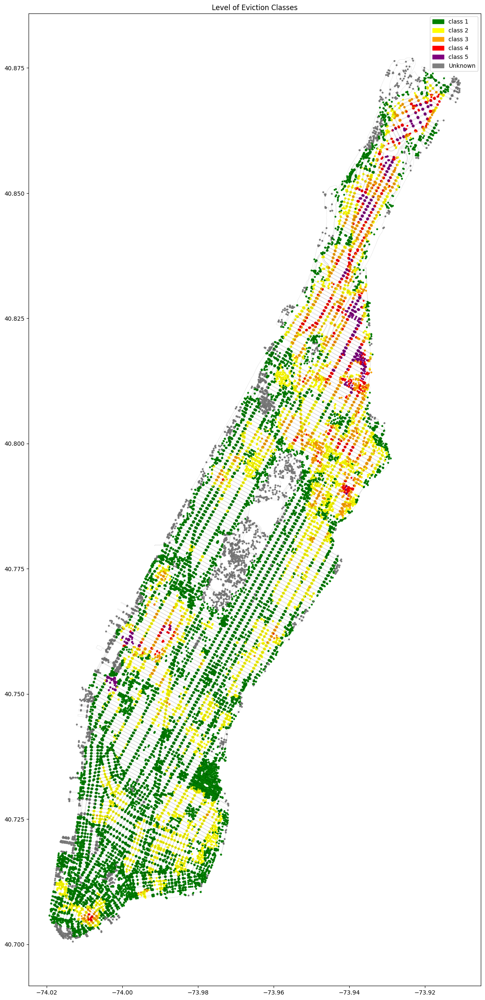

In [112]:
fig, ax = plt.subplots(figsize=(30,30))
edges.plot(ax=ax, linewidth=0.03, edgecolor="black")
he_colors_dict={1:"green", 2:"yellow", 3:"orange", 4:"red", 5:"purple", 6:"gray"}
he_colors=[he_colors_dict[i] for i in nodes["class"] ]
nodes.plot( ax=ax, color=he_colors , markersize=5 , legend=True)
ax.set_title('Level of Eviction Classes')

#create a legend
c0 = mpatches.Patch(color=he_colors_dict[1], label='class 1')
c1 = mpatches.Patch(color=he_colors_dict[2], label='class 2')
c2 = mpatches.Patch(color=he_colors_dict[3], label='class 3')
c3 = mpatches.Patch(color=he_colors_dict[4], label='class 4')
c4 = mpatches.Patch(color=he_colors_dict[5], label='class 5')
c5 = mpatches.Patch(color=he_colors_dict[6], label='Unknown')

plt.legend(handles=[c0, c1, c2, c3, c4, c5] )

plt.show()

In [113]:
from sklearn.model_selection import train_test_split

labeled_nodes=[i.numpy().item() for i,j in zip(graph.nodes(),graph.ndata["classes"]) if j != 6]
un_labeled_nodes=[i.numpy().item() for i,j in zip(graph.nodes(),graph.ndata["classes"]) if j == 6]

print(len(labeled_nodes))
print(len(un_labeled_nodes))

42844
3693


In [114]:
train_nodes, test_nodes= train_test_split(labeled_nodes, random_state=1, test_size=.1) #test
train_nodes, validation_nodes= train_test_split(train_nodes, random_state=1, test_size=.11)      #validation

prediction_nodes=un_labeled_nodes

print(len(train_nodes))
print(len(test_nodes))
print(len(validation_nodes))
print(len(prediction_nodes))

34317
4285
4242
3693


In [115]:
print(sorted(train_nodes))
train_mask={i.numpy().item() :False for i in graph.nodes()}
print(train_mask)
[train_mask.update({n:True}) for n in train_nodes]
print(train_mask)

[1, 2, 3, 5, 6, 7, 9, 10, 12, 13, 14, 15, 16, 17, 19, 20, 21, 22, 23, 25, 27, 28, 29, 33, 34, 36, 37, 39, 41, 42, 43, 45, 46, 47, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 75, 76, 78, 79, 80, 81, 82, 83, 84, 86, 87, 88, 89, 90, 91, 92, 93, 95, 98, 99, 102, 103, 106, 108, 109, 110, 111, 112, 113, 115, 117, 119, 120, 121, 122, 124, 125, 126, 127, 128, 130, 131, 132, 134, 135, 136, 137, 138, 139, 140, 141, 143, 144, 145, 146, 147, 148, 149, 151, 152, 153, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 168, 169, 170, 171, 172, 173, 174, 175, 176, 180, 181, 182, 183, 184, 185, 187, 188, 189, 190, 192, 193, 194, 195, 196, 198, 201, 202, 207, 208, 209, 210, 211, 212, 213, 214, 218, 219, 221, 222, 223, 225, 226, 227, 228, 229, 230, 231, 232, 234, 235, 236, 237, 238, 239, 240, 241, 242, 243, 244, 245, 246, 247, 248, 250, 251, 252, 253, 255, 256, 257, 258, 260, 262, 264, 265, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 278, 279, 281, 282, 2

In [116]:
print(sorted(validation_nodes))
validation_mask={i.numpy().item() :False for i in graph.nodes()}
[validation_mask.update({n:True}) for n in validation_nodes]
print(validation_mask)

[8, 18, 26, 30, 32, 35, 85, 94, 97, 104, 105, 118, 133, 154, 166, 177, 178, 179, 186, 191, 199, 206, 216, 220, 224, 254, 259, 261, 263, 266, 277, 285, 291, 303, 325, 329, 351, 355, 366, 376, 382, 384, 395, 408, 436, 474, 476, 477, 495, 496, 497, 514, 521, 539, 553, 566, 585, 590, 604, 642, 646, 665, 672, 700, 727, 728, 733, 747, 768, 771, 801, 804, 823, 826, 836, 838, 846, 850, 851, 855, 873, 877, 889, 917, 935, 936, 956, 965, 976, 987, 994, 1002, 1014, 1021, 1025, 1033, 1067, 1074, 1083, 1085, 1094, 1097, 1099, 1103, 1106, 1114, 1120, 1123, 1138, 1140, 1162, 1164, 1174, 1189, 1205, 1216, 1220, 1229, 1238, 1243, 1246, 1253, 1305, 1324, 1331, 1336, 1340, 1358, 1360, 1379, 1381, 1385, 1399, 1433, 1439, 1442, 1470, 1501, 1505, 1536, 1546, 1549, 1566, 1579, 1609, 1622, 1625, 1628, 1657, 1711, 1717, 1727, 1736, 1742, 1743, 1756, 1763, 1790, 1800, 1804, 1808, 1809, 1830, 1831, 1846, 1864, 1868, 1870, 1878, 1900, 1916, 1919, 1941, 1948, 1949, 1955, 1968, 1985, 2017, 2019, 2032, 2035, 2036, 20

In [117]:
print(sorted(test_nodes))
test_mask={i.numpy().item() :False for i in graph.nodes()}
[test_mask.update({n:True}) for n in test_nodes]
print(test_mask)

[4, 11, 24, 44, 48, 49, 77, 96, 100, 101, 107, 114, 116, 123, 129, 142, 150, 167, 197, 200, 203, 204, 205, 215, 217, 249, 280, 292, 297, 314, 326, 335, 349, 354, 359, 368, 372, 378, 392, 405, 419, 433, 470, 471, 507, 542, 545, 555, 556, 558, 571, 573, 574, 597, 601, 611, 614, 631, 639, 650, 653, 663, 675, 679, 685, 688, 696, 697, 705, 732, 743, 749, 759, 779, 783, 788, 791, 796, 812, 815, 825, 831, 834, 839, 843, 849, 859, 862, 868, 872, 876, 893, 895, 934, 945, 946, 958, 963, 977, 979, 983, 985, 1006, 1024, 1030, 1043, 1057, 1077, 1086, 1087, 1091, 1105, 1109, 1150, 1167, 1180, 1194, 1203, 1209, 1214, 1225, 1226, 1227, 1263, 1276, 1283, 1288, 1299, 1303, 1318, 1321, 1326, 1328, 1330, 1343, 1350, 1351, 1359, 1365, 1378, 1380, 1382, 1395, 1406, 1409, 1430, 1459, 1475, 1517, 1537, 1551, 1552, 1570, 1573, 1575, 1595, 1623, 1624, 1627, 1643, 1650, 1660, 1664, 1667, 1682, 1694, 1696, 1702, 1725, 1731, 1734, 1744, 1746, 1751, 1757, 1760, 1769, 1782, 1802, 1819, 1869, 1886, 1904, 1908, 1910, 

In [118]:
print(sorted(prediction_nodes))
prediction_mask={i.numpy().item() :False for i in graph.nodes()}
[prediction_mask.update({n:True}) for n in prediction_nodes]
print(prediction_mask)

[0, 31, 38, 40, 60, 61, 73, 74, 233, 287, 288, 296, 301, 302, 534, 587, 612, 618, 625, 636, 702, 774, 820, 833, 908, 909, 928, 932, 947, 1023, 1047, 1064, 1148, 1153, 1170, 1171, 1208, 1320, 1353, 1364, 1375, 1392, 1396, 1412, 1423, 1428, 1429, 1432, 1434, 1436, 1437, 1438, 1446, 1449, 1450, 1451, 1452, 1453, 1456, 1458, 1460, 1461, 1464, 1465, 1467, 1471, 1477, 1484, 1489, 1490, 1499, 1502, 1503, 1507, 1510, 1511, 1518, 1519, 1521, 1522, 1525, 1527, 1529, 1530, 1531, 1532, 1533, 1534, 1535, 1554, 1555, 1556, 1560, 1561, 1562, 1563, 1564, 1567, 1576, 1596, 1603, 1605, 1607, 1637, 1639, 1642, 1644, 1646, 1647, 1648, 1652, 1656, 1659, 1672, 1688, 1689, 1690, 1691, 1692, 1697, 1698, 1701, 1713, 1719, 1720, 1721, 1726, 1737, 1747, 1758, 1762, 1771, 1772, 1773, 1775, 1776, 1784, 1785, 1786, 1787, 1789, 1807, 1814, 1820, 1821, 1834, 1836, 1837, 1843, 1844, 1845, 1848, 1850, 1851, 1860, 1888, 1898, 1899, 1905, 1911, 1918, 1926, 1950, 1951, 1953, 1959, 1960, 1961, 1962, 1963, 1964, 1965, 1966,

In [119]:
reorder_dict={}
for i,j in enumerate([o.numpy().item() for o in graph.ndata["gdf_order"]]):
  reorder_dict[j]=i
print(reorder_dict)

{0: 0, 14: 1, 27: 2, 38: 3, 50: 4, 61: 5, 73: 6, 85: 7, 97: 8, 107: 9, 118: 10, 129: 11, 141: 12, 152: 13, 163: 14, 176: 15, 177: 16, 190: 17, 200: 18, 211: 19, 222: 20, 233: 21, 245: 22, 256: 23, 265: 24, 278: 25, 288: 26, 299: 27, 312: 28, 321: 29, 328: 30, 336: 31, 347: 32, 358: 33, 360: 34, 370: 35, 379: 36, 364: 37, 381: 38, 401: 39, 412: 40, 425: 41, 438: 42, 451: 43, 464: 44, 475: 45, 486: 46, 497: 47, 509: 48, 520: 49, 529: 50, 538: 51, 548: 52, 561: 53, 572: 54, 579: 55, 590: 56, 602: 57, 615: 58, 157: 59, 637: 60, 650: 61, 664: 62, 677: 63, 688: 64, 699: 65, 711: 66, 724: 67, 731: 68, 745: 69, 756: 70, 760: 71, 773: 72, 783: 73, 794: 74, 809: 75, 813: 76, 825: 77, 836: 78, 848: 79, 863: 80, 877: 81, 12: 82, 895: 83, 906: 84, 910: 85, 738: 86, 926: 87, 939: 88, 953: 89, 701: 90, 960: 91, 973: 92, 984: 93, 992: 94, 1002: 95, 1015: 96, 1019: 97, 1030: 98, 1042: 99, 1052: 100, 1060: 101, 1072: 102, 1082: 103, 1095: 104, 1105: 105, 1116: 106, 1126: 107, 1139: 108, 1151: 109, 1154:

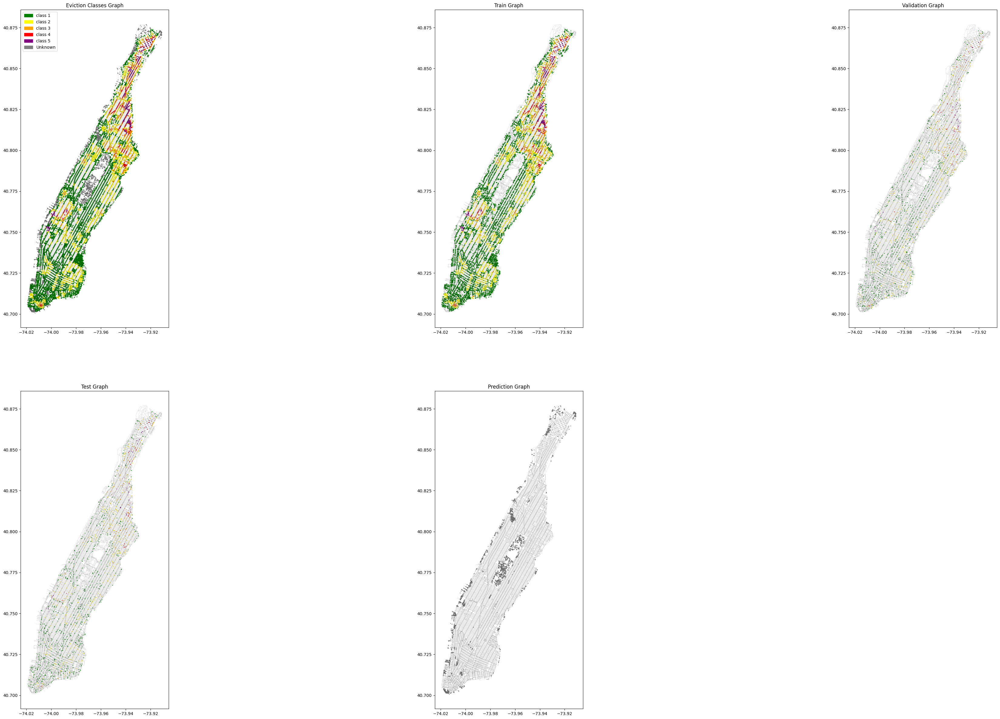

In [120]:
fig = plt.figure(figsize=(50,30))
he_colors_dict={1:"green", 2:"yellow", 3:"orange", 4:"red", 5:"purple", 6:"gray"}
classes_list=[t[0] for t in graph.ndata["classes"].tolist()]
classes_list_reordered=[classes_list[reorder_dict[i]] for i in sorted(reorder_dict.keys())]

out_of_mask_color="white"

# Graph
ax = fig.add_subplot(2,3,1)
edges.plot(ax=ax, linewidth=0.03, edgecolor="black")
he_colors=[he_colors_dict[i] for i in nodes["class"]]
nodes.plot(ax=ax, color=he_colors , markersize=0.6 , legend=True)
ax.set_title('Eviction Classes Graph')

c0 = mpatches.Patch(color=he_colors_dict[1], label='class 1')
c1 = mpatches.Patch(color=he_colors_dict[2], label='class 2')
c2 = mpatches.Patch(color=he_colors_dict[3], label='class 3')
c3 = mpatches.Patch(color=he_colors_dict[4], label='class 4')
c4 = mpatches.Patch(color=he_colors_dict[5], label='class 5')
c5 = mpatches.Patch(color=he_colors_dict[6], label='Unknown')

plt.legend(handles=[c0, c1, c2, c3, c4, c5] )

#Train mask
ax = fig.add_subplot(2,3,2)
edges.plot(ax=ax, linewidth=0.03, edgecolor="black")

train_colors=[he_colors_dict[j] if train_mask[reorder_dict[i]]==True else out_of_mask_color for i,j in enumerate(classes_list_reordered) ] #dont use nodes["classes"] since the nodes order changed in dgl graph
nodes.plot(ax=ax, color=train_colors , markersize=0.6 , legend=True)
ax.set_title('Train Graph')

#Validation mask
ax = fig.add_subplot(2,3,3)
edges.plot(ax=ax, linewidth=0.03, edgecolor="black")

validation_colors=[he_colors_dict[j] if validation_mask[reorder_dict[i]]==True else out_of_mask_color for i,j in enumerate(classes_list_reordered) ]
nodes.plot(ax=ax, color=validation_colors , markersize=0.6 , legend=True)
ax.set_title('Validation Graph')

#Test mask
ax = fig.add_subplot(2,3,4)
edges.plot(ax=ax, linewidth=0.03, edgecolor="black")

test_colors=[he_colors_dict[j] if test_mask[reorder_dict[i]]==True else out_of_mask_color for i,j in enumerate(classes_list_reordered) ]
nodes.plot(ax=ax, color=test_colors , markersize=0.6 , legend=True)
ax.set_title('Test Graph')

#prediction mask
ax = fig.add_subplot(2,3,5)
edges.plot(ax=ax, linewidth=0.03, edgecolor="black")

prediction_colors=[he_colors_dict[j] if prediction_mask[reorder_dict[i]]==True else out_of_mask_color for i,j in enumerate(classes_list_reordered) ]
nodes.plot(ax=ax, color=prediction_colors , markersize=0.6 , legend=True)
ax.set_title('Prediction Graph')

plt.show()

In [121]:
graph.ndata["train_mask"]=torch.tensor(list(train_mask.values()))
graph.ndata["validation_mask"]=torch.tensor(list(validation_mask.values()))
graph.ndata["test_mask"]=torch.tensor(list(test_mask.values()))
graph.ndata["prediction_mask"]=torch.tensor(list(prediction_mask.values()))

In [122]:
class SAGE(nn.Module):
    def __init__(self, in_feats, hid_feats, out_feats):
        super().__init__()
        self.conv1 = SAGEConv(in_feats=in_feats, out_feats=hid_feats, aggregator_type='mean')
        self.conv2 = SAGEConv(in_feats=hid_feats, out_feats=out_feats, aggregator_type='mean')

    def forward(self, graph, inputs):
        # inputs are features of nodes
        h = self.conv1(graph, inputs)
        h = F.relu(h)
        h = self.conv2(graph, h)
        return h

In [123]:
n_features=graph.ndata["feat"].shape[1]
classes_list=[t[0] for t in graph.ndata["classes"].tolist()]
n_labels=len(Counter(classes_list).keys())

In [124]:
n_hidden=8
lr=0.03
n_epochs=200
device='cpu'

In [125]:
model = SAGE(in_feats=n_features, hid_feats=n_hidden, out_feats=n_labels)
optimizer = torch.optim.Adam(model.parameters(), lr=lr)
model_path="walk-nodes"
torch.manual_seed(710)
best_val_acc = 0
best_test_acc = 0

features = graph.ndata['feat']
labels = graph.ndata['classes']
train_mask_1 = graph.ndata['train_mask']
val_mask_1 = graph.ndata['validation_mask']
test_mask_1 = graph.ndata['test_mask']

train_accs=[]
valid_accs=[]

for e in range(n_epochs):
    # Forward
    logits = model(graph, features)

    # Compute prediction
    pred = logits.argmax(1)

    # Compute loss
    # Note that you should only compute the losses of the nodes in the training set.
    loss = F.cross_entropy(logits[train_mask_1], labels[train_mask_1].squeeze())

    # Compute accuracy on training/validation/test
    train_acc = (pred[train_mask_1] == labels[train_mask_1]).float().mean()
    val_acc = (pred[val_mask_1] == labels[val_mask_1]).float().mean()
    # test_acc = (pred[test_mask_1] == labels[test_mask_1]).float().mean()

    train_accs.append(train_acc)
    valid_accs.append(val_acc)

    # Save the best validation accuracy and the corresponding test accuracy.
    if best_val_acc < val_acc:
        best_val_acc = val_acc
        torch.save(model.state_dict(), model_path)

    # Backward
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

    print('In epoch {}, loss: {:.3f}, train acc: {:.3f}, val acc: {:.3f}'.format(e, loss, train_acc, val_acc))

In epoch 0, loss: 42.983, train acc: 0.090, val acc: 0.092
In epoch 1, loss: 29.723, train acc: 0.090, val acc: 0.092
In epoch 2, loss: 17.248, train acc: 0.089, val acc: 0.091
In epoch 3, loss: 13.332, train acc: 0.253, val acc: 0.254
In epoch 4, loss: 10.119, train acc: 0.248, val acc: 0.249
In epoch 5, loss: 6.226, train acc: 0.186, val acc: 0.187
In epoch 6, loss: 3.899, train acc: 0.482, val acc: 0.491
In epoch 7, loss: 5.530, train acc: 0.597, val acc: 0.601
In epoch 8, loss: 7.046, train acc: 0.601, val acc: 0.604
In epoch 9, loss: 7.896, train acc: 0.601, val acc: 0.604
In epoch 10, loss: 8.202, train acc: 0.601, val acc: 0.604
In epoch 11, loss: 8.075, train acc: 0.601, val acc: 0.604
In epoch 12, loss: 7.609, train acc: 0.601, val acc: 0.604
In epoch 13, loss: 6.914, train acc: 0.600, val acc: 0.603
In epoch 14, loss: 6.350, train acc: 0.511, val acc: 0.513
In epoch 15, loss: 5.694, train acc: 0.395, val acc: 0.397
In epoch 16, loss: 4.724, train acc: 0.507, val acc: 0.509
In

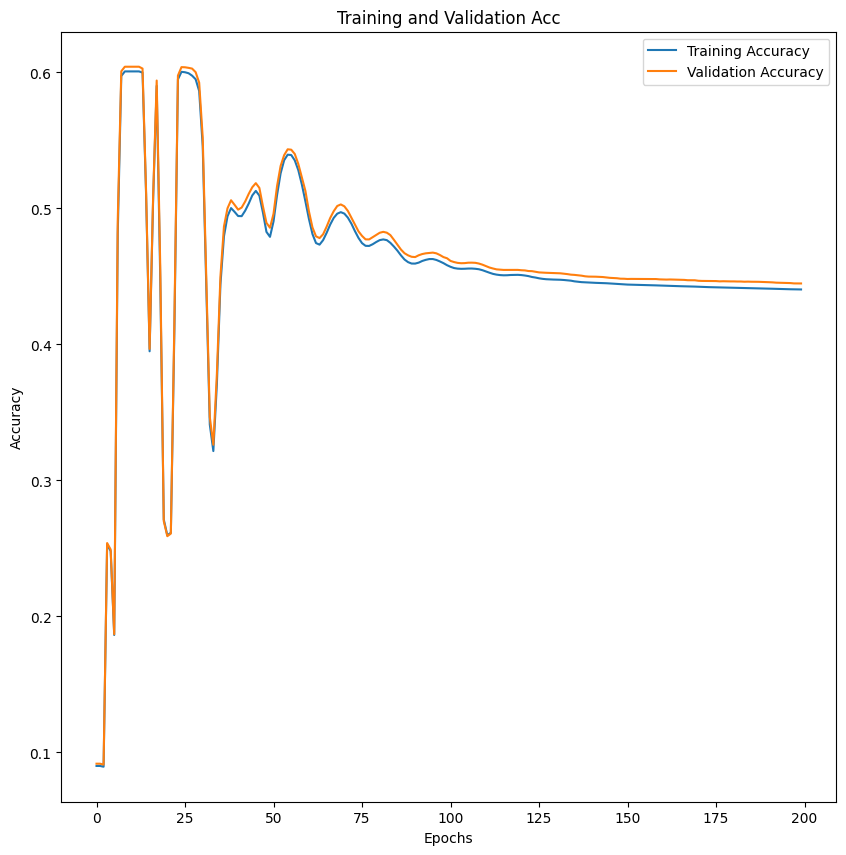

In [126]:
%matplotlib inline
fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(1,1,1)

plt.plot(range(n_epochs), [a.numpy().item() for a in train_accs], label='Training Accuracy')
plt.plot(range(n_epochs), [a.numpy().item() for a in valid_accs], label='Validation Accuracy')

# Add in a title and axes labels
plt.title('Training and Validation Acc')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')

# Display the plot
plt.legend(loc='best')
plt.show()

In [127]:
reorder_dict={}
for i,j in enumerate([o.numpy().item() for o in graph.ndata["gdf_order"]]):
  reorder_dict[j]=i
print(reorder_dict)

{0: 0, 14: 1, 27: 2, 38: 3, 50: 4, 61: 5, 73: 6, 85: 7, 97: 8, 107: 9, 118: 10, 129: 11, 141: 12, 152: 13, 163: 14, 176: 15, 177: 16, 190: 17, 200: 18, 211: 19, 222: 20, 233: 21, 245: 22, 256: 23, 265: 24, 278: 25, 288: 26, 299: 27, 312: 28, 321: 29, 328: 30, 336: 31, 347: 32, 358: 33, 360: 34, 370: 35, 379: 36, 364: 37, 381: 38, 401: 39, 412: 40, 425: 41, 438: 42, 451: 43, 464: 44, 475: 45, 486: 46, 497: 47, 509: 48, 520: 49, 529: 50, 538: 51, 548: 52, 561: 53, 572: 54, 579: 55, 590: 56, 602: 57, 615: 58, 157: 59, 637: 60, 650: 61, 664: 62, 677: 63, 688: 64, 699: 65, 711: 66, 724: 67, 731: 68, 745: 69, 756: 70, 760: 71, 773: 72, 783: 73, 794: 74, 809: 75, 813: 76, 825: 77, 836: 78, 848: 79, 863: 80, 877: 81, 12: 82, 895: 83, 906: 84, 910: 85, 738: 86, 926: 87, 939: 88, 953: 89, 701: 90, 960: 91, 973: 92, 984: 93, 992: 94, 1002: 95, 1015: 96, 1019: 97, 1030: 98, 1042: 99, 1052: 100, 1060: 101, 1072: 102, 1082: 103, 1095: 104, 1105: 105, 1116: 106, 1126: 107, 1139: 108, 1151: 109, 1154:

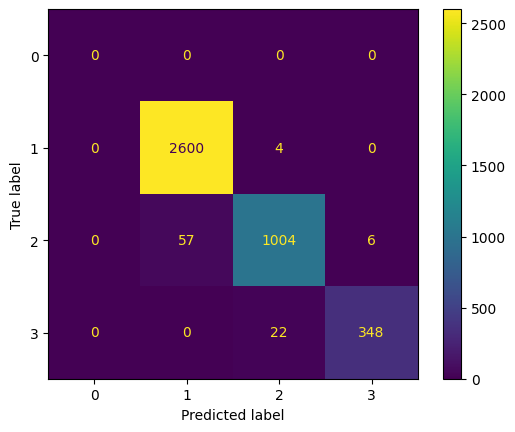

In [128]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

y_test= labels[test_mask_1]
predictions = pred[test_mask_1]
cm = confusion_matrix(y_test, predictions, labels=[0,1,2,3])
disp = ConfusionMatrixDisplay(confusion_matrix=cm,display_labels=[0,1,2,3])
disp.plot()
plt.show()